### Project Description

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.
Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
#### 1. Problem Statement: 
a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


Dataset Description:
Number of columns: 23


- Date  - The date of observation
- Location  -The common name of the location of the weather station
- MinTemp  -The minimum temperature in degrees celsius
- MaxTemp -The maximum temperature in degrees celsius
- Rainfall  -The amount of rainfall recorded for the day in mm
- Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am
- Sunshine  -The number of hours of bright sunshine in the day.
- WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight
- WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight
- WindDir9am -Direction of the wind at 9am
- WindDir3pm -Direction of the wind at 3pm
- WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am
- WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm
- Humidity9am -Humidity (percent) at 9am
- Humidity3pm -Humidity (percent) at 3pm
- Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am
- Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm
- Cloud9am - Fraction of sky obscured by cloud at 9am. 
- Cloud3pm -Fraction of sky obscured by cloud 
- Temp9am-Temperature (degrees C) at 9am
- Temp3pm -Temperature (degrees C) at 3pm
- RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0
- RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

Dataset Link-  
•	https://github.com/FlipRoboTechnologies/ML_-Datasets/blob/main/Rainfall%20Forecast/Rainfall.csv



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
DF=pd.read_csv('https://raw.githubusercontent.com/FlipRoboTechnologies/ML_-Datasets/main/Rainfall%20Forecast/Rainfall.csv')
DF

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


- We will be working on the analysis of 8425 rows and 23 columns.

# Exploratory Data Analysis

In [3]:
DF.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [4]:
DF.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [5]:
DF.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [6]:
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

#### OBSERVATION:

1.There are 16 float64 datatypes, and 7 Object  datatype. 

2.Data column is object datatype and we will havee to treatn it.

3.Many columns have null values, we will have to fill thhem all as all ccolumn are important. 

In [7]:
#Checking Null values
DF.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

#### OBSERVATIONS:

1.From the above it is been observed that many columns have null values except Location and Date. 

2.All columns which are important and having significant amount of Null values, we need to study them and treat them .


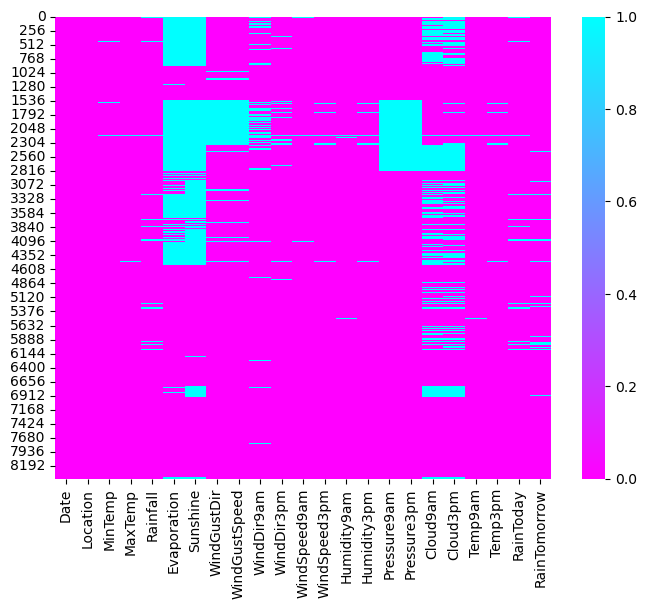

In [8]:
#Missing Value check
plt.figure(figsize = (8,6))
sns.heatmap(DF.isnull(),cmap = 'cool_r')
plt.show()

##### It is very clear from heatmap that we have lots of null values and we will have top treat them with imputation technique.

In [9]:
# checking the value counts of each column
for i in DF.columns:
    print (DF[i].value_counts())
    print('\n')

2011-01-31    5
2011-05-08    5
2011-05-21    5
2011-05-20    5
2011-05-19    5
             ..
2013-01-28    1
2013-01-29    1
2013-01-30    1
2013-01-31    1
2013-06-08    1
Name: Date, Length: 3004, dtype: int64


Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


 12.0    74
 13.2    71
 13.8    69
 12.7    68
 16.4    67
         ..
 0.3      1
 28.3     1
-1.1      1
-1.4      1
 26.0     1
Name: MinTemp, Length: 285, dtype: int64


19.0    87
23.8    75
19.8    74
25.0    71
22.0    68
        ..
11.2     1
43.1     1
42.7     1
42.9     1
43.5     1
Name: MaxTemp, Length: 331, dtype: int64


0.0      5299
0.2       406
0.4       177
0.6       116
1.2        86
         ... 
61.2        1
128.0       1
90.0        1
34.4        1
40.0        1
Name: R

In [10]:
# Extract useful features from the date
DF['Date'] = pd.to_datetime(DF['Date'])
DF['Month'] = DF['Date'].dt.month
DF['Year'] = DF['Date'].dt.year
DF = DF.drop(columns=['Date'])

In [11]:
DF

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Month,Year
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,12,2008
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,12,2008
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,12,2008
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,12,2008
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,...,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No,6,2017
8421,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,...,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No,6,2017
8422,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,...,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No,6,2017
8423,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,...,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No,6,2017


# Imputation of all values using Interactive Imputer Technique. 

In [12]:
#Before using Iterative Imputer, we need to enalbe it using the below code
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
df_imp = IterativeImputer()
df_imp = pd.DataFrame(df_imp.fit_transform(DF[['Rainfall','MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']]), columns = ['Rainfall','MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'])

df_imp

,Rainfall,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,0.6,13.4,22.900000,5.146735,6.567859,44.000000,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,0.0,7.4,25.100000,5.824202,12.406433,44.000000,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,0.0,12.9,25.700000,7.243981,11.820881,46.000000,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,0.0,9.2,28.000000,5.406861,12.886565,24.000000,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,17.5,32.300000,5.333187,6.369314,41.000000,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,0.0,2.8,23.400000,4.079790,11.912692,31.000000,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,0.0,3.6,25.300000,3.812303,12.548026,22.000000,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,0.0,5.4,26.900000,5.611019,12.315648,37.000000,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1
8423,0.0,7.8,27.000000,5.883597,11.106576,28.000000,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0


In [13]:
df_imp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Rainfall       8425 non-null   float64
 1   MinTemp        8425 non-null   float64
 2   MaxTemp        8425 non-null   float64
 3   Evaporation    8425 non-null   float64
 4   Sunshine       8425 non-null   float64
 5   WindGustSpeed  8425 non-null   float64
 6   WindSpeed9am   8425 non-null   float64
 7   WindSpeed3pm   8425 non-null   float64
 8   Humidity9am    8425 non-null   float64
 9   Humidity3pm    8425 non-null   float64
 10  Pressure9am    8425 non-null   float64
 11  Pressure3pm    8425 non-null   float64
 12  Cloud9am       8425 non-null   float64
 13  Cloud3pm       8425 non-null   float64
 14  Temp9am        8425 non-null   float64
 15  Temp3pm        8425 non-null   float64
dtypes: float64(16)
memory usage: 1.0 MB


In [14]:
DF.drop(columns=['Rainfall','MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'],inplace=True)

In [15]:
DF

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year
0,Albury,W,W,WNW,No,No,12,2008
1,Albury,WNW,NNW,WSW,No,No,12,2008
2,Albury,WSW,W,WSW,No,No,12,2008
3,Albury,NE,SE,E,No,No,12,2008
4,Albury,W,ENE,NW,No,No,12,2008
...,...,...,...,...,...,...,...,...
8420,Uluru,E,SE,ENE,No,No,6,2017
8421,Uluru,NNW,SE,N,No,No,6,2017
8422,Uluru,N,SE,WNW,No,No,6,2017
8423,Uluru,SE,SSE,N,No,No,6,2017


In [16]:
df = pd .concat([DF,df_imp],axis=1)

In [17]:
df

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,Albury,W,W,WNW,No,No,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,Albury,WNW,NNW,WSW,No,No,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,Albury,WSW,W,WSW,No,No,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,Albury,NE,SE,E,No,No,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,Albury,W,ENE,NW,No,No,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,E,SE,ENE,No,No,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,Uluru,NNW,SE,N,No,No,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,Uluru,N,SE,WNW,No,No,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1
8423,Uluru,SE,SSE,N,No,No,6,2017,0.0,7.8,...,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0


In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Location       8425 non-null   object 
 1   WindGustDir    7434 non-null   object 
 2   WindDir9am     7596 non-null   object 
 3   WindDir3pm     8117 non-null   object 
 4   RainToday      8185 non-null   object 
 5   RainTomorrow   8186 non-null   object 
 6   Month          8425 non-null   int64  
 7   Year           8425 non-null   int64  
 8   Rainfall       8425 non-null   float64
 9   MinTemp        8425 non-null   float64
 10  MaxTemp        8425 non-null   float64
 11  Evaporation    8425 non-null   float64
 12  Sunshine       8425 non-null   float64
 13  WindGustSpeed  8425 non-null   float64
 14  WindSpeed9am   8425 non-null   float64
 15  WindSpeed3pm   8425 non-null   float64
 16  Humidity9am    8425 non-null   float64
 17  Humidity3pm    8425 non-null   float64
 18  Pressure

In [19]:
#Checking Null values again
df.isnull().sum()

Location           0
WindGustDir      991
WindDir9am       829
WindDir3pm       308
RainToday        240
RainTomorrow     239
Month              0
Year               0
Rainfall           0
MinTemp            0
MaxTemp            0
Evaporation        0
Sunshine           0
WindGustSpeed      0
WindSpeed9am       0
WindSpeed3pm       0
Humidity9am        0
Humidity3pm        0
Pressure9am        0
Pressure3pm        0
Cloud9am           0
Cloud3pm           0
Temp9am            0
Temp3pm            0
dtype: int64

# Imputing all the categorical columns with Mode Imputation

In [20]:
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Location       8425 non-null   object 
 1   WindGustDir    8425 non-null   object 
 2   WindDir9am     8425 non-null   object 
 3   WindDir3pm     8425 non-null   object 
 4   RainToday      8425 non-null   object 
 5   RainTomorrow   8186 non-null   object 
 6   Month          8425 non-null   int64  
 7   Year           8425 non-null   int64  
 8   Rainfall       8425 non-null   float64
 9   MinTemp        8425 non-null   float64
 10  MaxTemp        8425 non-null   float64
 11  Evaporation    8425 non-null   float64
 12  Sunshine       8425 non-null   float64
 13  WindGustSpeed  8425 non-null   float64
 14  WindSpeed9am   8425 non-null   float64
 15  WindSpeed3pm   8425 non-null   float64
 16  Humidity9am    8425 non-null   float64
 17  Humidity3pm    8425 non-null   float64
 18  Pressure

#### Target RainTomorroww remains to be treated . But its better to drop it thee NA rows as its target and we cannot assume. 

In [22]:
df = df.dropna()

In [23]:
df.isnull().sum()

Location         0
WindGustDir      0
WindDir9am       0
WindDir3pm       0
RainToday        0
RainTomorrow     0
Month            0
Year             0
Rainfall         0
MinTemp          0
MaxTemp          0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

#### Now lets see if we have any duplicate values

In [25]:
# Check for duplicates
duplicates = df.duplicated()

# Display rows that are duplicates
duplicate_rows = df[duplicates]

print("Duplicate Rows:")
print(duplicate_rows)

Duplicate Rows:
         Location WindGustDir WindDir9am WindDir3pm RainToday RainTomorrow  \
1737    Newcastle           N          N         SE        No           No   
1738    Newcastle           N          N         SE        No           No   
3674  Williamtown           E          N          E        No           No   
3675  Williamtown         NNW         NW        ESE        No          Yes   
3678  Williamtown           E         NW          E        No          Yes   
...           ...         ...        ...        ...       ...          ...   
6140    Melbourne          SE        ENE        ESE        No           No   
6141    Melbourne           N          N          E        No           No   
6142    Melbourne           N          N        SSE        No           No   
6143    Melbourne           S          S        SSW        No           No   
6147    Melbourne           N         NE        NNE        No          Yes   

      Month  Year  Rainfall    MinTemp  ...  Wi

In [26]:
# Dropping the duplicates
df= df.drop_duplicates()
df

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,Albury,W,W,WNW,No,No,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,Albury,WNW,NNW,WSW,No,No,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,Albury,WSW,W,WSW,No,No,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,Albury,NE,SE,E,No,No,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,Albury,W,ENE,NW,No,No,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,Uluru,E,ESE,E,No,No,6,2017,0.0,3.5,...,15.0,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,Uluru,E,SE,ENE,No,No,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,Uluru,NNW,SE,N,No,No,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,Uluru,N,SE,WNW,No,No,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


#### There is a huge data loss here. But Model Building cant be done with Null or Duplicate values. hense we have to remove them.

In [28]:
df.shape

(6622, 24)

#### Checking if any white spaces remain in the Target column

In [31]:
df.loc[df['Rainfall'] == " "]

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm


In [32]:
df.loc[df['RainTomorrow'] == " "]

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm


#### All the null values and duplicates have been treated well and fifilled and removed. Lets move futher with Data Visualization and Interpretation

# Separating Numerical and Categorical column

In [50]:
#checking for categorical columns
categorical_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]=="object":
        categorical_col.append(i)
print("Categorical Columns:",categorical_col)

#checking numerical Columns
numerical_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]!="object":
        numerical_col.append(i)
print("Numerical Columns:",numerical_col)

Categorical Columns: ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']
Numerical Columns: ['Month', 'Year', 'Rainfall', 'MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


# Data Visualization and Interpretation

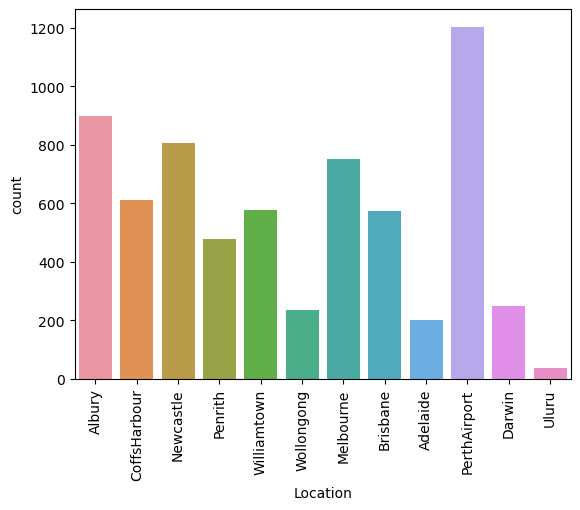

In [30]:
# Plot distribution of Location
sns.countplot(x='Location', data=df)
# Rotate x-axis labels to 90 degrees
plt.xticks(rotation=90)
plt.show()

##### The dataframe has most of the readings from Perth Airport followed by Albury

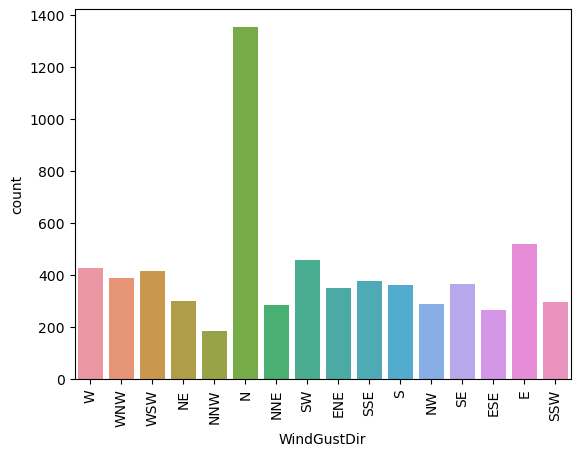

In [33]:
# Plot distribution of WindGustDir
sns.countplot(x='WindGustDir', data=df)
# Rotate x-axis labels to 90 degrees
plt.xticks(rotation=90)
plt.show()

##### North is the most noticed the direction of the strongest wind gust in the 24 hours to midnight while the least noticed is North-NorthWest

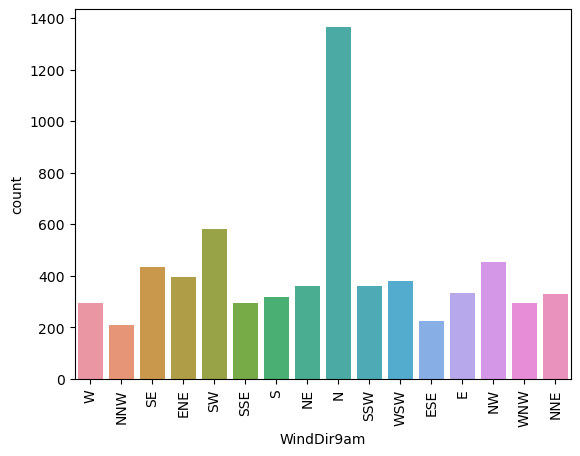

In [34]:
# Plot distribution of WindDir9am
sns.countplot(x='WindDir9am', data=df)
# Rotate x-axis labels to 90 degrees
plt.xticks(rotation=90)
plt.show()

##### The most noticed Direction of the wind at 9am is North and the least is North-NothWest 

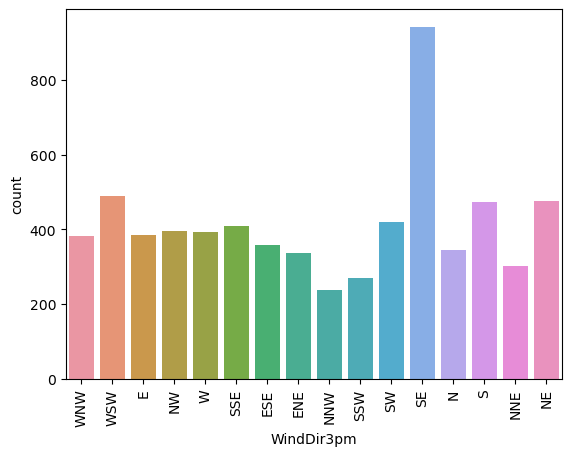

In [35]:
# Plot distribution of WindDir3pm
sns.countplot(x='WindDir3pm', data=df)
# Rotate x-axis labels to 90 degrees
plt.xticks(rotation=90)
plt.show()

##### Whereas at 3 pm it can be noticed that Direction of the wind is towards Sowth West and Least towards North North West 

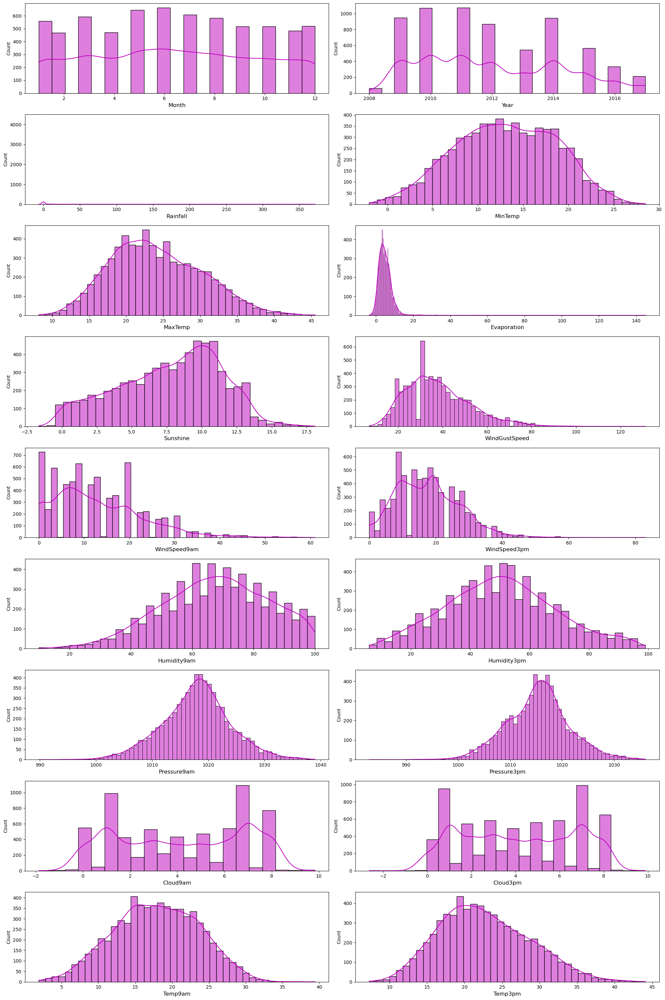

In [52]:
#Letss check how data is distributed in numerical columns
plt.figure(figsize = (20,30), facecolor="white")
plotnumber= 1
for col in numerical_col:
    if plotnumber<=len(numerical_col):
        ax = plt.subplot (9,2,plotnumber)
        sns.histplot (df[col],kde=True,color='m')
        plt.xlabel(col,fontsize= 12 )
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

- Evaporation, WindGustSpeed, WindSpeed9am, WindSpeed3pm, are right or postively skewed. Rest of the data seem to be equally spread. 

# Bivariate Analysis

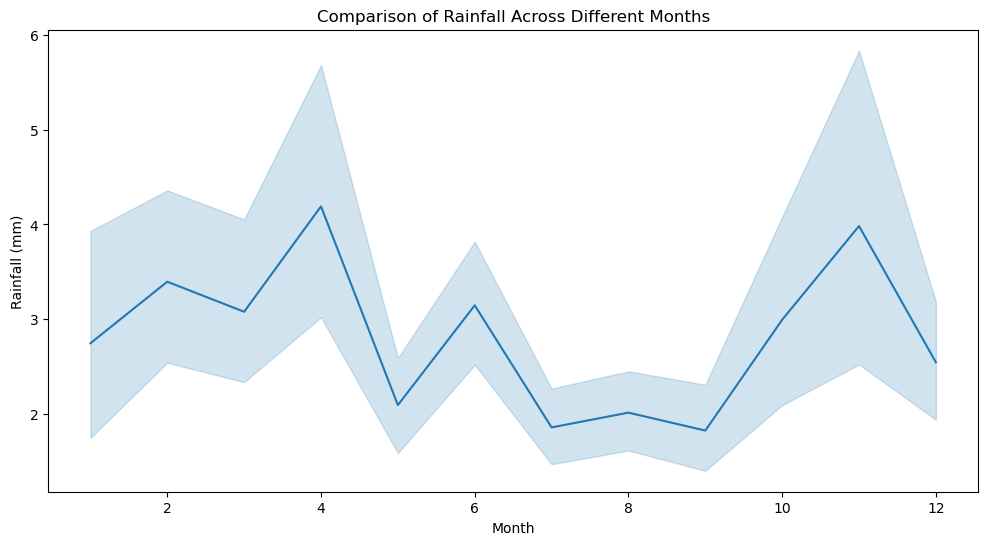

In [42]:
# Plot comparison between Rainfall and Month
plt.figure(figsize=(12, 6))
sns.lineplot(x='Month', y='Rainfall', data=df)

# Set plot title and labels
plt.title('Comparison of Rainfall Across Different Months')
plt.xlabel('Month')
plt.ylabel('Rainfall (mm)')

# Display the plot
plt.show()

##### Rainfall seems to be highest in the month of April and lowest in July and October

In [45]:
# Calculate the average rainfall for each month
monthly_rainfall = df.groupby('Month')['Rainfall'].mean().reset_index()
monthly_rainfall

,Month,Rainfall
0,1,2.744695
1,2,3.394807
2,3,3.077348
3,4,4.191117
4,5,2.091407
5,6,3.145552
6,7,1.855440
7,8,2.011509
8,9,1.822360
9,10,2.992625


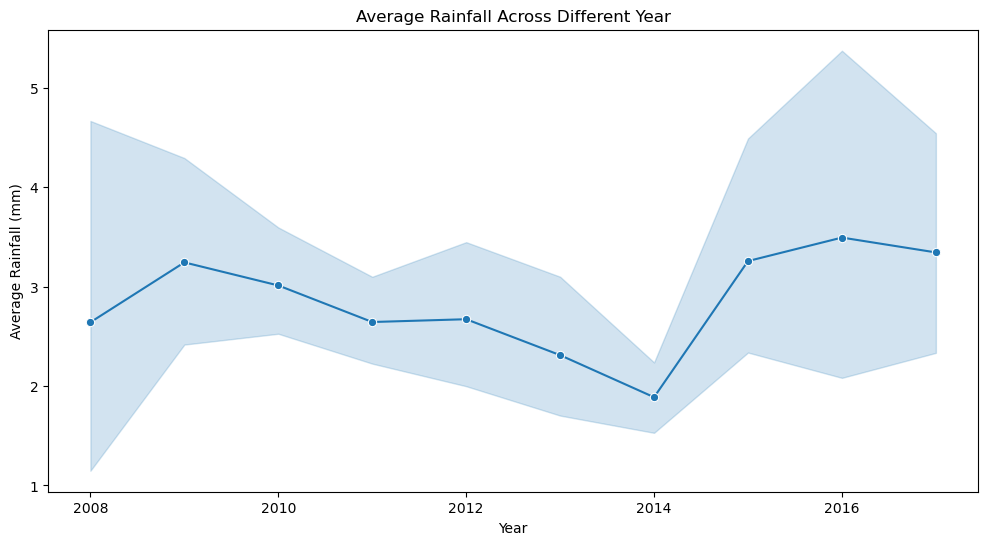

In [46]:
# Plot the average rainfall per month using a line plot
plt.figure(figsize=(12, 6))
sns.lineplot(x='Year', y='Rainfall', data=df, marker='o')

# Set plot title and labels
plt.title('Average Rainfall Across Different Year')
plt.xlabel('Year')
plt.ylabel('Average Rainfall (mm)')

# Display the plot
plt.show()

In [47]:
# Calculate the average rainfall for each month
Yearly_rainfall = df.groupby('Year')['Rainfall'].mean().reset_index()
Yearly_rainfall

,Year,Rainfall
0,2008,2.641487
1,2009,3.243638
2,2010,3.011580
3,2011,2.643883
4,2012,2.672012
5,2013,2.310681
6,2014,1.887440
7,2015,3.256968
8,2016,3.493362
9,2017,3.343925


##### Highest rainfall have been observed in the year 2009, 2015,2016 and 2017

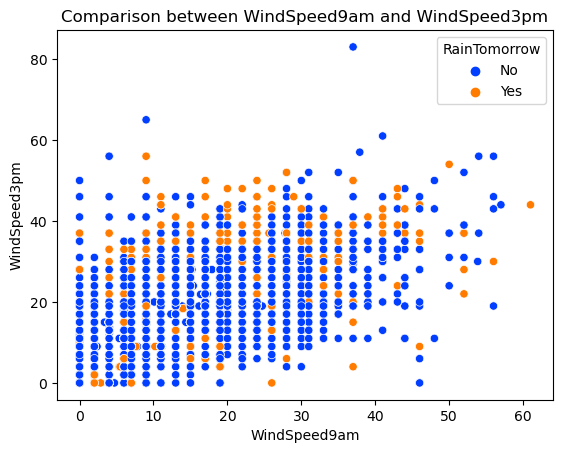

In [53]:
plt.title("Comparison between WindSpeed9am and WindSpeed3pm")
sns.scatterplot (x="WindSpeed9am", y="WindSpeed3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

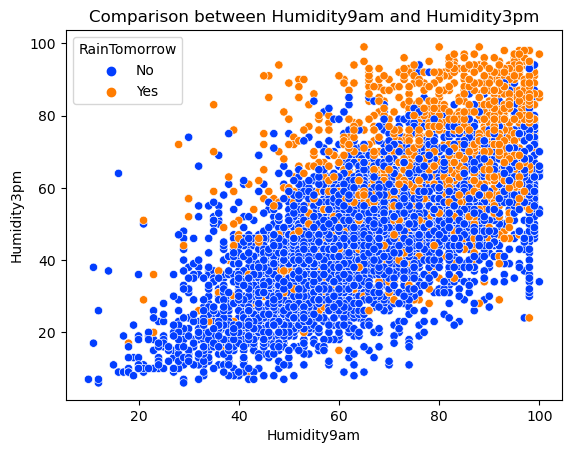

In [54]:
plt.title("Comparison between Humidity9am and Humidity3pm")
sns.scatterplot (x="Humidity9am", y="Humidity3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

- As Humidity increased chances of rainfall also increased. 

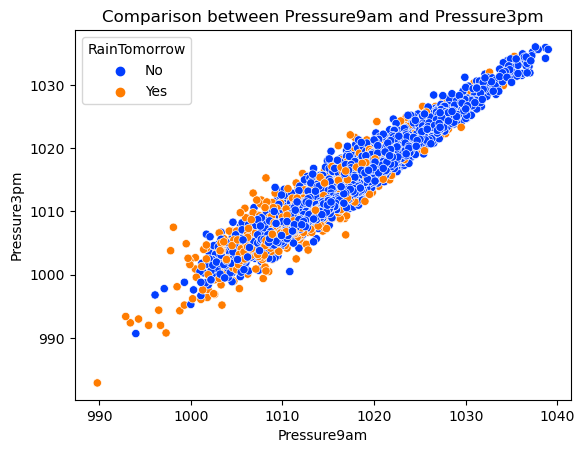

In [55]:
plt.title("Comparison between Pressure9am and Pressure3pm")
sns.scatterplot (x="Pressure9am", y="Pressure3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

- When the pressure seems to be less rainfall is recieved with the increase in pressure rainfall stops at 9 am or 3 pm

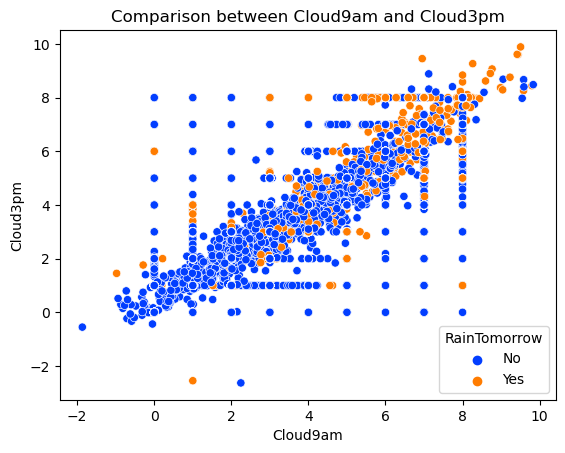

In [56]:
plt.title("Comparison between Cloud9am and Cloud3pm")
sns.scatterplot (x="Cloud9am", y="Cloud3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

- At 9 am or 3 pm the more the clouds lesser the rains. with decreasing the clouds Rainfall increases

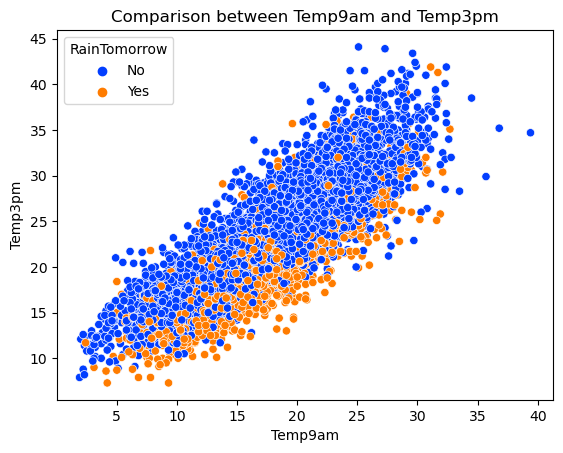

In [57]:
plt.title("Comparison between Temp9am and Temp3pm")
sns.scatterplot (x="Temp9am", y="Temp3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

- In the morning with less Temperature there are more chances of Rainfall, While in the afternoon chances of rainfall with any type of temperature is less 

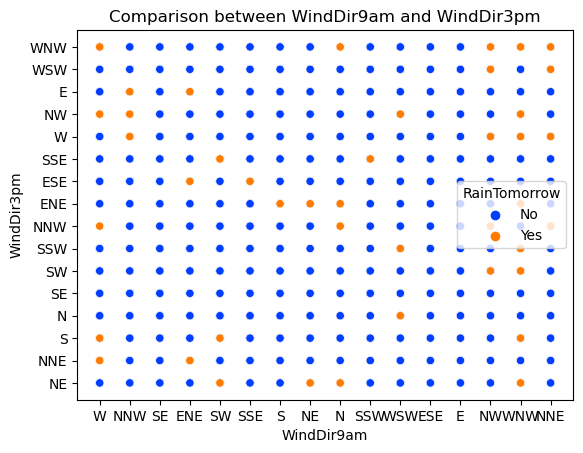

In [58]:
plt.title("Comparison between WindDir9am and WindDir3pm")
sns.scatterplot (x="WindDir9am", y="WindDir3pm",data=df, hue='RainTomorrow',palette='bright')
plt.show()

- There dont seems to be any relation with Wind Direction at any time

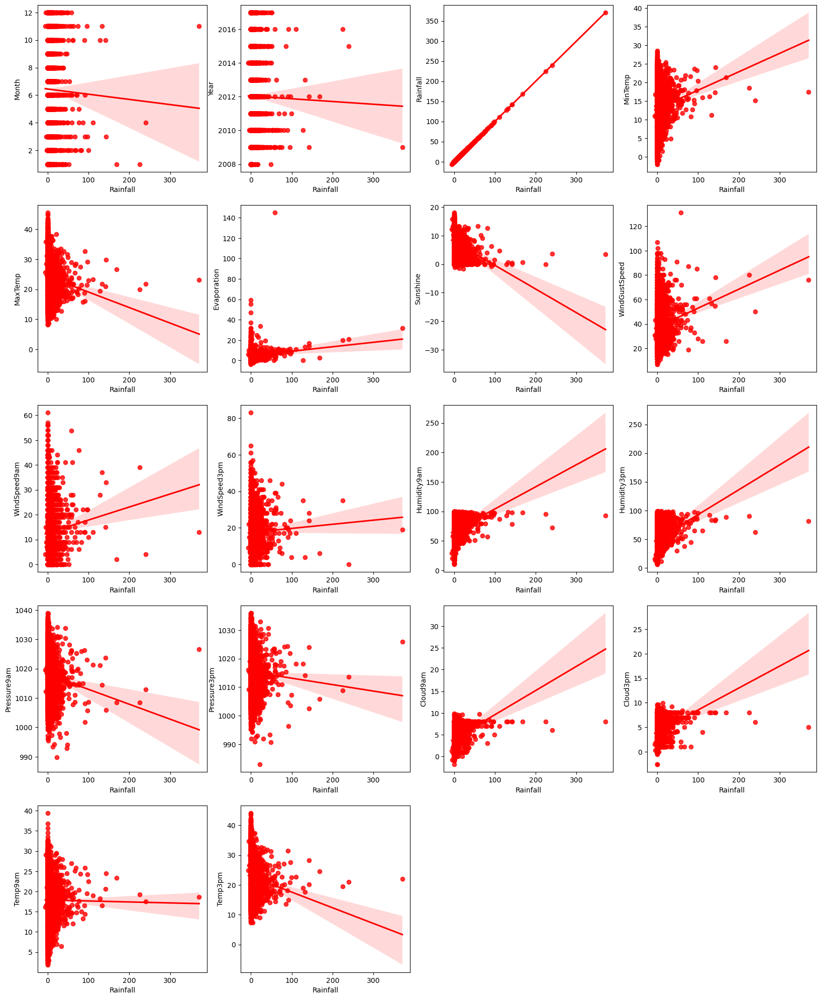

In [59]:
plt.figure(figsize=(20,25))
p=1
for i in numerical_col:
    if p<=len(numerical_col):
        plt.subplot(5,4,p)
        sns.regplot(x='Rainfall',y=i,data=df,color='r')
        plt.xlabel('Rainfall')
        plt.ylabel(i)
    p+=1
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

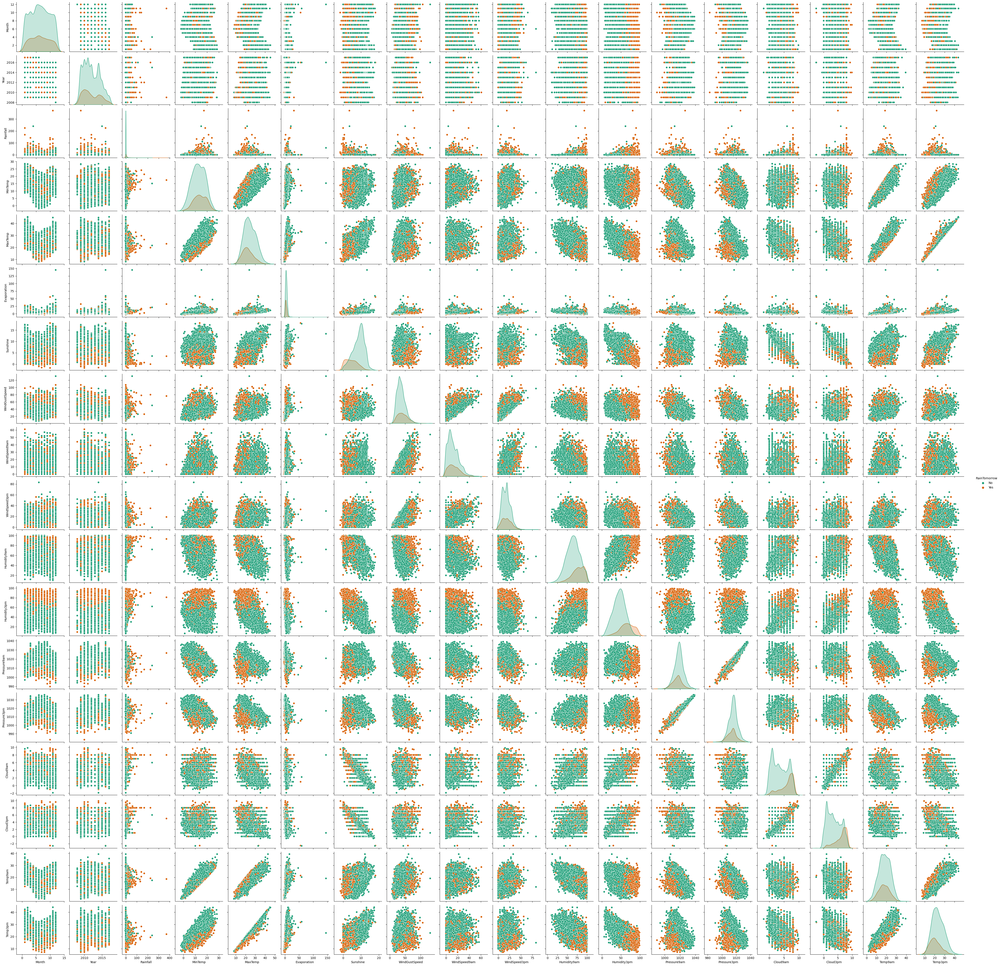

In [60]:
sns.pairplot(df,hue="RainTomorrow", palette="Dark2")
plt.show

# Descriptive Statistics

In [61]:
df.describe()

,Month,Year,Rainfall,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000,6622.000000
mean,6.435669,2012.036696,2.775748,13.076070,24.081967,4.886237,7.697274,37.865459,12.745087,17.504785,67.462317,50.410253,1017.883580,1015.330605,4.179802,4.157253,17.886489,22.680752
std,3.358509,2.297076,10.554376,5.571136,6.139503,3.895547,3.652601,14.459940,9.809765,9.584215,17.226409,18.578461,6.125754,6.041719,2.683132,2.525456,5.738760,5.989063
min,1.000000,2008.000000,-5.995908,-2.000000,8.200000,-3.614712,-1.653687,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,-1.866715,-2.630109,1.900000,7.300000
25%,4.000000,2010.000000,0.000000,9.000000,19.500000,2.600000,5.000000,28.000000,6.000000,9.000000,56.000000,38.000000,1014.200000,1011.500000,1.703925,2.000000,13.800000,18.300000
50%,6.000000,2012.000000,0.000000,13.100000,23.400000,4.400000,8.229523,35.000000,11.000000,17.000000,68.000000,50.000000,1018.100000,1015.500000,4.065059,4.000000,17.900000,22.100000
75%,9.000000,2014.000000,1.000000,17.400000,28.400000,6.606786,10.500000,46.000000,19.000000,24.000000,80.000000,62.508355,1021.500000,1018.800000,7.000000,7.000000,22.200000,26.800000
max,12.000000,2017.000000,371.000000,28.500000,45.500000,145.000000,18.090984,131.206997,61.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,9.833482,9.888378,39.400000,44.100000


### OBSERVATIONS:
1.Mean is greater than Median for Rainfall,MaxTemp,Evaporation,WindGustSpeed,WindSpeed9am rest have a slight difference. These columns are slightly right or positively skewed.

2.Mean is lesser than Median for Sunshine,Humidity9am,Pressure9am,Temp9am.Those columns are left skewed or neegativey skewed. 

3.In all the columns it is observed there is a huge difference between Max or Quartile 3(75%). Hense lots of Outliers presnrt in the data and we have to treat them. 

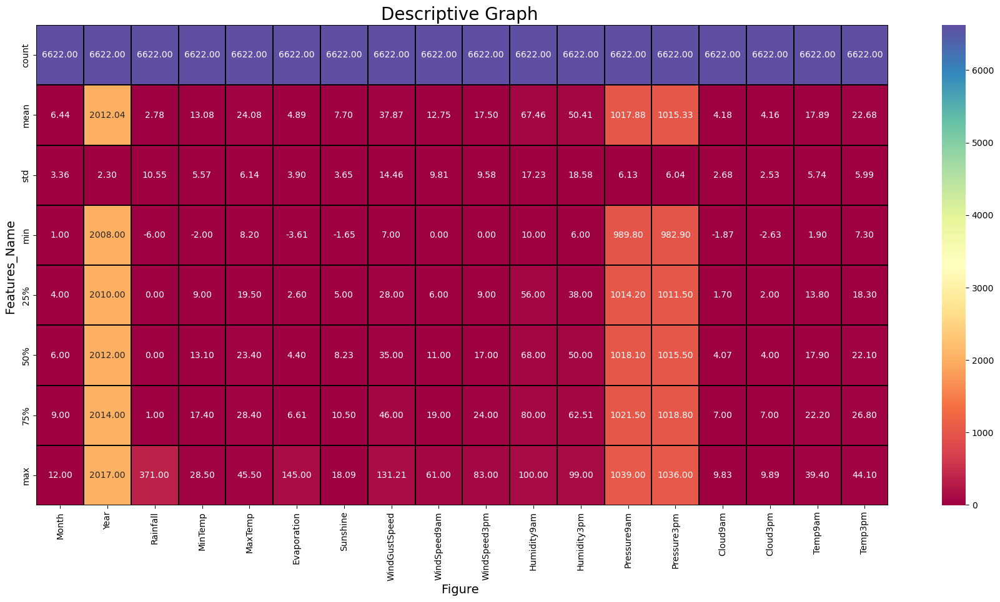

In [62]:
plt.figure(figsize=(22,10))
sns.heatmap(df.describe(),annot=True,fmt='0.2f',linewidth=0.2,linecolor='black',cmap='Spectral')
plt.xlabel('Figure ',fontsize=14)
plt.ylabel('Features_Name ',fontsize=14)
plt.title('Descriptive Graph ',fontsize=20)
plt.show()

# Encoding Categorical values to NUmerical Values

In [66]:
#Encoding categorical column using ordinal Method
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in df.columns:
    if df[i].dtypes=='object':
        df[i]=OE.fit_transform(df[i].values.reshape(-1,1))
df

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,0.0,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,0.0,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,0.0,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,0.0,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,0.0,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,0.0,6,2017,0.0,3.5,...,15.0,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,0.0,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,0.0,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,0.0,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


# Finding Correlation

In [67]:
cor=df.corr()
cor

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
Location,1.000000,-0.076309,-0.092975,0.002194,-0.001795,-0.001423,-0.079597,0.498450,-0.003115,0.085785,...,0.245362,0.228692,-0.037086,-0.002583,-0.019000,-0.008481,0.040141,0.040480,0.094237,0.061222
WindGustDir,-0.076309,1.000000,0.385507,0.503669,0.123989,0.049160,0.040379,-0.123763,0.035906,-0.152498,...,0.013537,0.107315,0.039359,0.046106,-0.126133,-0.040012,0.109067,0.079630,-0.171156,-0.227412
WindDir9am,-0.092975,0.385507,1.000000,0.216756,0.158975,0.041730,0.019687,-0.063995,0.092410,-0.020787,...,0.057945,0.046687,0.012625,0.125349,-0.046447,0.041223,0.099577,0.079841,-0.070187,-0.200909
WindDir3pm,0.002194,0.503669,0.216756,1.000000,0.094387,0.004938,0.037816,0.014995,0.031945,-0.139755,...,0.010795,0.084788,-0.007153,-0.010838,-0.139397,-0.046477,0.070021,0.051473,-0.144486,-0.173440
RainToday,-0.001795,0.123989,0.158975,0.094387,1.000000,0.324455,0.000574,-0.012412,0.458204,0.079543,...,0.036023,0.014738,0.389312,0.381631,-0.128821,-0.047675,0.353791,0.312186,-0.089304,-0.235175
RainTomorrow,-0.001423,0.049160,0.041730,0.004938,0.324455,1.000000,0.000753,-0.011231,0.228149,0.102361,...,0.060610,0.047093,0.294621,0.476927,-0.175860,-0.143111,0.355068,0.415566,-0.024925,-0.205286
Month,-0.079597,0.040379,0.019687,0.037816,0.000574,0.000753,1.000000,-0.097277,-0.011847,-0.248268,...,0.029618,0.054990,-0.098653,-0.052444,0.033934,0.031287,-0.029363,-0.012458,-0.170897,-0.198515
Year,0.498450,-0.123763,-0.063995,0.014995,-0.012412,-0.011231,-0.097277,1.000000,-0.007489,0.024336,...,-0.103265,-0.084442,0.082277,-0.033424,0.070588,0.056031,-0.013259,-0.023961,0.036999,0.080908
Rainfall,-0.003115,0.035906,0.092410,0.031945,0.458204,0.228149,-0.011847,-0.007489,1.000000,0.094109,...,0.056398,0.024749,0.230376,0.246839,-0.087569,-0.039445,0.219465,0.187467,-0.004453,-0.092598
MinTemp,0.085785,-0.152498,-0.020787,-0.139755,0.079543,0.102361,-0.248268,0.024336,0.094109,1.000000,...,0.170792,0.191625,-0.157322,0.071554,-0.488401,-0.485189,0.129534,0.077624,0.893657,0.701755


<Axes: >

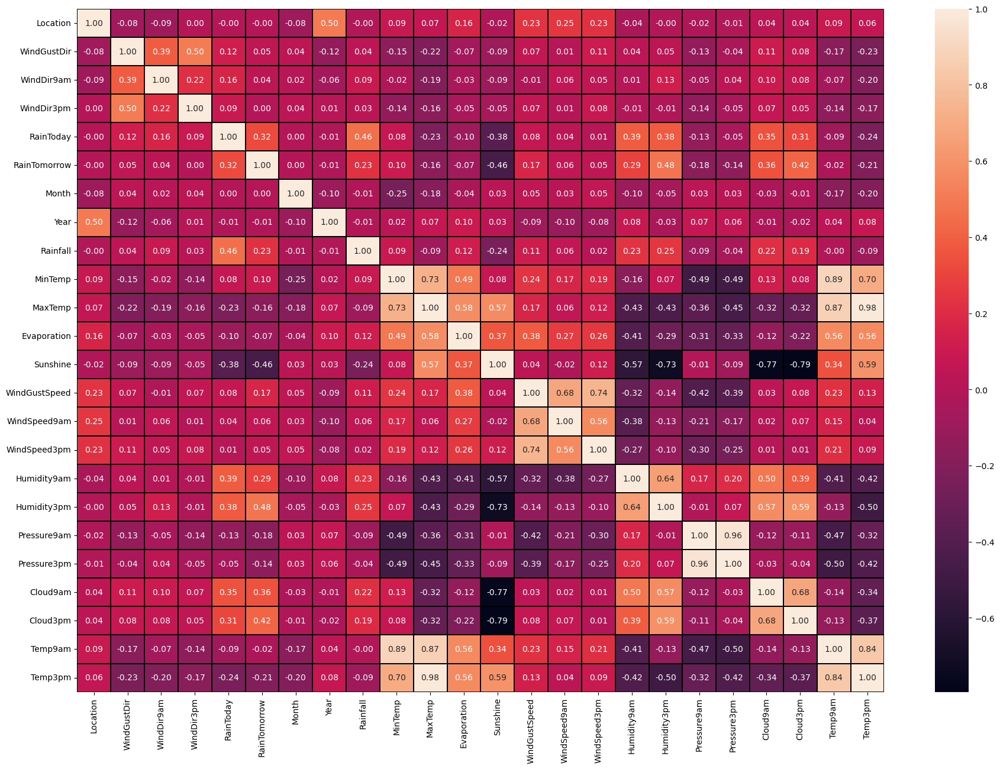

In [68]:
plt.figure(figsize=(22,15))
sns.heatmap(df.corr(),annot=True,linewidths=0.1,linecolor="black",fmt='0.2f')

#### OBSERVATION:
1.Humidity9am, Humidity3pm, Clound9am and Cloud3pm are highly correlsted to Sunshine. RainToday, RainTomorrow are moderately correlated to Sunshine. 

2.Humidity9am, Humidity3pm, Pressure9am, Pressure3pm, Cloud9am, Cloud3pm are moderately negatiively correlated to Temp9am and Temp3pm. Temp9am and Temp3pm are highly correlated to MinTemp and MaxTemp. 

3.Mintemp and Maxtemp, WindGustspeed and Windspeed9am and Windspeed3pm,Humidity9pm and Humidity3pm, Pressure9am and Pressure3pm, Cloud9am and Cloud3pm, Temp9am and Temp3pm, all are highly correlatd to each other respectively. 

4.Definetly the data has Multicollonearity issue and we will have to treate it. 

In [76]:
cor["Rainfall"].sort_values(ascending=True)

Sunshine        -0.240559
Temp3pm         -0.092598
MaxTemp         -0.088701
Pressure9am     -0.087569
Pressure3pm     -0.039445
Month           -0.011847
Year            -0.007489
Temp9am         -0.004453
Location        -0.003115
WindSpeed3pm     0.024749
WindDir3pm       0.031945
WindGustDir      0.035906
WindSpeed9am     0.056398
WindDir9am       0.092410
MinTemp          0.094109
WindGustSpeed    0.113275
Evaporation      0.118499
Cloud3pm         0.187467
Cloud9am         0.219465
RainTomorrow     0.228149
Humidity9am      0.230376
Humidity3pm      0.246839
RainToday        0.458204
Rainfall         1.000000
Name: Rainfall, dtype: float64

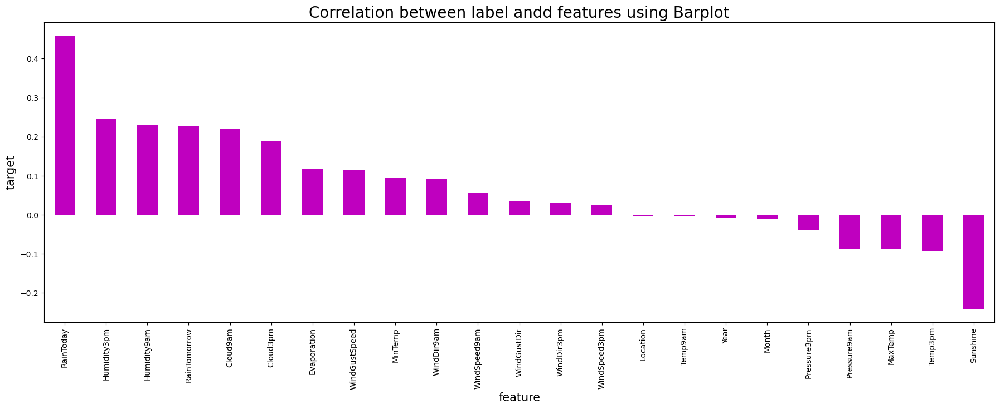

In [78]:
#visualizing correlation between Features and Target by bar plot
plt.figure(figsize=(22,7))
df.corr()["Rainfall"].sort_values(ascending=False).drop(["Rainfall"]).plot(kind='bar',color="m")
plt.xlabel("feature",fontsize=15)
plt.ylabel("target",fontsize=15)
plt.title("Correlation between label andd features using Barplot", fontsize=20)
plt.show()

##### Only RainToday has a moderate correlation with Rainfall

In [77]:
cor["RainTomorrow"].sort_values(ascending=True)

Sunshine        -0.457016
Temp3pm         -0.205286
Pressure9am     -0.175860
MaxTemp         -0.162654
Pressure3pm     -0.143111
Evaporation     -0.073826
Temp9am         -0.024925
Year            -0.011231
Location        -0.001423
Month            0.000753
WindDir3pm       0.004938
WindDir9am       0.041730
WindSpeed3pm     0.047093
WindGustDir      0.049160
WindSpeed9am     0.060610
MinTemp          0.102361
WindGustSpeed    0.171695
Rainfall         0.228149
Humidity9am      0.294621
RainToday        0.324455
Cloud9am         0.355068
Cloud3pm         0.415566
Humidity3pm      0.476927
RainTomorrow     1.000000
Name: RainTomorrow, dtype: float64

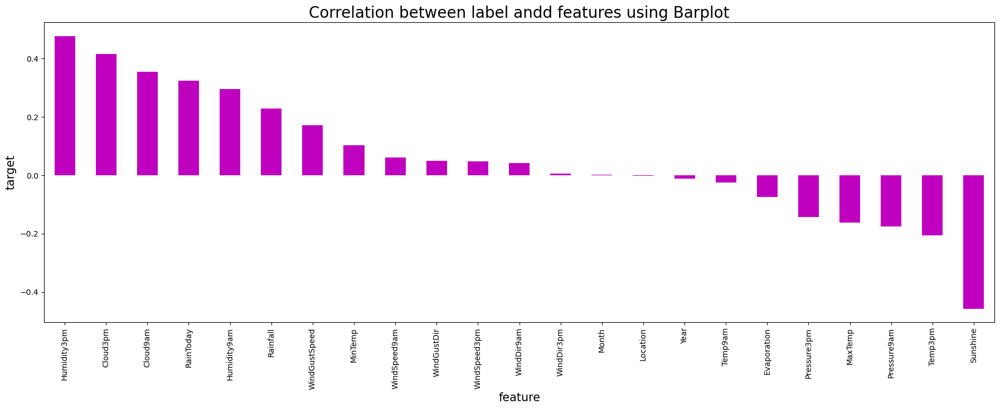

In [79]:
#visualizing correlation between Features and Target by bar plot
plt.figure(figsize=(22,7))
df.corr()["RainTomorrow"].sort_values(ascending=False).drop(["RainTomorrow"]).plot(kind='bar',color="m")
plt.xlabel("feature",fontsize=15)
plt.ylabel("target",fontsize=15)
plt.title("Correlation between label andd features using Barplot", fontsize=20)
plt.show()

##### RainToday,Cloud9am,Cloud3pm and Humidity3pm has moderate correlation . Sunshine has negative moderate correlation with RainTomorrow.

# Finding Outliers

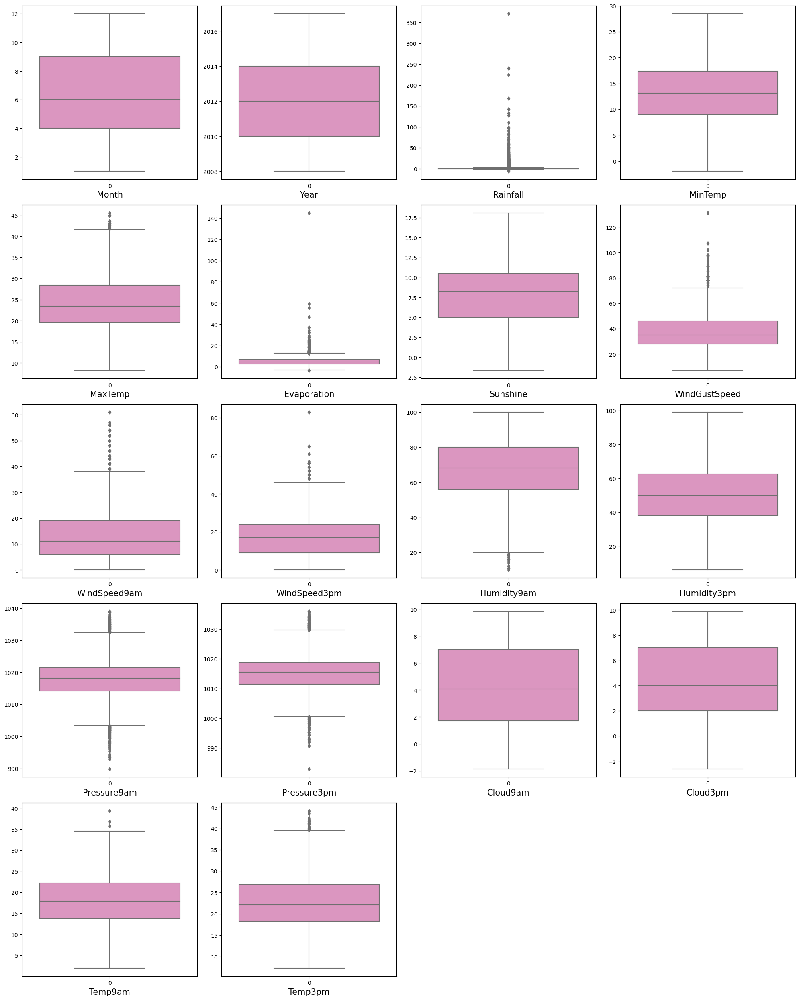

In [69]:
#checking outliers by Boxplot
plt.figure(figsize = (20,25), facecolor="white")
plotnumber= 1
for col in numerical_col:
    if plotnumber<=len(numerical_col):
        ax = plt.subplot (5,4,plotnumber)
        sns.boxplot (df[col],palette='Set2_r')
        plt.xlabel(col,fontsize= 15 )
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

#### OBSERVATIONS:
- Rainfall, Maxtemp, Evaporation, WindGustSpeed, WindSpeed9am, WindSpeed3pm, Humidity9am, Pressure9am, Pressure3pm, Temp9am and Temp3pm have outliers in them.We will have to treat the outliers 

# Oultiers Removal Technique

In [70]:
#Treating outliers with Z-score method
from scipy.stats import zscore
import numpy as np
z=np.abs(zscore(df))
threshold=3
np.where(z>3)

(array([  12,   12,   43,   43,   51,   51,   59,   59,   60,   60,   61,
          61,   61,   66,   67,   67,  122,  266,  270,  294,  379,  379,
         403,  404,  405,  429,  455,  458,  458,  555,  559,  560,  560,
         561,  594,  674,  674,  690,  704,  739,  739,  761,  787,  788,
         793,  925,  939,  969,  970,  970,  970,  998,  999, 1001, 1128,
        1138, 1139, 1139, 1141, 1179, 1193, 1227, 1231, 1254, 1255, 1347,
        1401, 1402, 1469, 1470, 1471, 1503, 1525, 1577, 1634, 1651, 1655,
        1663, 1670, 1762, 1800, 1854, 1879, 1879, 1884, 1926, 1997, 2009,
        2024, 2054, 2088, 2096, 2162, 2175, 2175, 2193, 2193, 2193, 2204,
        2205, 2239, 2403, 2461, 2473, 2499, 2499, 2513, 2565, 2648, 2649,
        2706, 2796, 2804, 2813, 2813, 2819, 2823, 2827, 2833, 2841, 2847,
        2854, 2855, 2861, 2862, 2864, 2864, 2865, 2869, 2873, 2875, 2883,
        2889, 2897, 2903, 2911, 2917, 2925, 2931, 2936, 2950, 2964, 2986,
        3010, 3010, 3017, 3018, 3018, 

In [71]:
df1=df[(z<3).all(axis=1)]
df1

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,0.0,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,0.0,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,0.0,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,0.0,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,0.0,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,0.0,6,2017,0.0,3.5,...,15.0,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,0.0,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,0.0,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,0.0,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


In [72]:
#Using IQR Method
from scipy import stats
IQR = stats.iqr(df)
IQR

26.520143410811787

In [73]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

In [74]:
df2 = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]
df2

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,0.0,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,0.0,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,0.0,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,0.0,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,0.0,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,0.0,6,2017,0.0,3.5,...,15.0,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,0.0,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,0.0,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,0.0,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


#### We see that IQR method has removed outliers with less data loss Hense we will consider IQR Method for Outlier Removal Technique

# As we have 2 Targets to work on lets first make 2 copies of the data so that modelling can done as per the Target

In [104]:
# Creating copies of the DataFrame for each target
df_rf=df2.copy() #for the target Rainfall
df_RT=df2.copy() #for the target RainTomororw

# Lets first work for the Target 'RainTomorrow'

# Finding Skewness 

In [105]:
df_RT.skew()

Location        -0.001876
WindGustDir      0.178050
WindDir9am       0.220812
WindDir3pm      -0.116938
RainToday        1.300888
RainTomorrow     1.274060
Month            0.025223
Year             0.356306
Rainfall         3.743947
MinTemp         -0.067972
MaxTemp          0.323254
Evaporation      1.607148
Sunshine        -0.333441
WindGustSpeed    0.644266
WindSpeed9am     0.899789
WindSpeed3pm     0.466967
Humidity9am     -0.222695
Humidity3pm      0.158191
Pressure9am     -0.046156
Pressure3pm     -0.011748
Cloud9am        -0.052278
Cloud3pm         0.016778
Temp9am         -0.055921
Temp3pm          0.352923
dtype: float64

In [110]:
df_RT["Rainfall"]=np.cbrt(df_RT["Rainfall"])

In [107]:
from sklearn.preprocessing import PowerTransformer
from scipy.stats import skew
# Initialize the PowerTransformer with Yeo-Johnson method
pt = PowerTransformer(method='yeo-johnson')
# Apply the PowerTransformer to Evaporation, WindGustSpeed, WindSpeed9am
df_RT[['Evaporation', 'WindGustSpeed', 'WindSpeed9am']] = pt.fit_transform(df_RT[['Evaporation', 'WindGustSpeed', 'WindSpeed9am']])

In [111]:
df_RT.skew()

Location        -0.001876
WindGustDir      0.178050
WindDir9am       0.220812
WindDir3pm      -0.116938
RainToday        1.300888
RainTomorrow     1.274060
Month            0.025223
Year             0.356306
Rainfall         0.752883
MinTemp         -0.067972
MaxTemp          0.323254
Evaporation      0.161616
Sunshine        -0.333441
WindGustSpeed   -0.010932
WindSpeed9am    -0.107236
WindSpeed3pm     0.466967
Humidity9am     -0.222695
Humidity3pm      0.158191
Pressure9am     -0.046156
Pressure3pm     -0.011748
Cloud9am        -0.052278
Cloud3pm         0.016778
Temp9am         -0.055921
Temp3pm          0.352923
dtype: float64

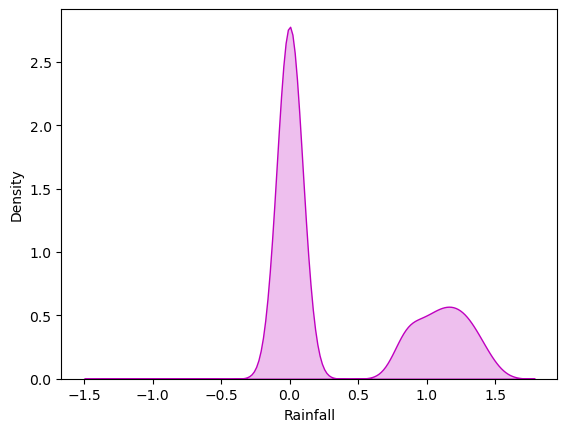

In [113]:
#Let Visualize if the skewneww is removed. 
sns.distplot(df_RT["Rainfall"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

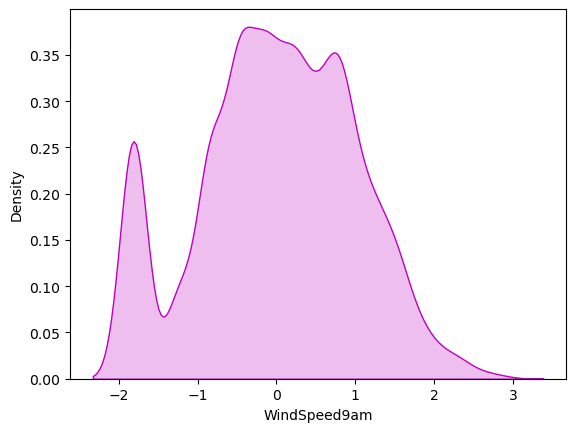

In [114]:
#Let Visualize if the skewneww is removed. 
sns.distplot(df_RT["WindSpeed9am"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

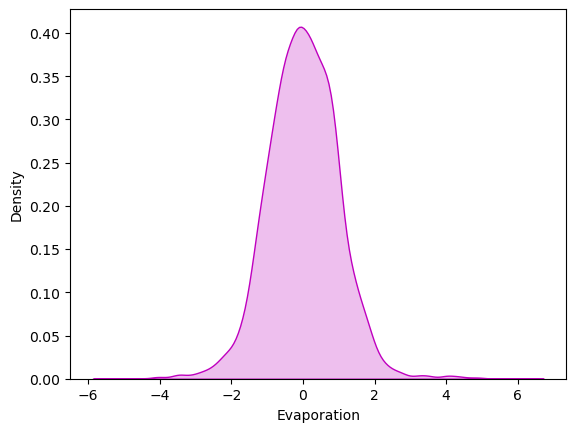

In [115]:
#Let Visualize if the skewneww is removed. 
sns.distplot(df_RT["Evaporation"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

#### We have skewed that numerical columns and now its ready for scalarization

# Separating Features and Label/target variables

In [116]:
x=df_RT.drop("RainTomorrow",axis=1)
y=df_RT["RainTomorrow"]

In [117]:
x

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,Month,Year,Rainfall,MinTemp,MaxTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,12,2008,0.944822,13.4,22.9,...,0.845220,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,12,2008,0.000000,7.4,25.1,...,-0.851272,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,12,2008,0.000000,12.9,25.7,...,0.767690,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,12,2008,0.000000,9.2,28.0,...,0.050807,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,12,2008,1.000000,17.5,32.3,...,-0.411422,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,6,2017,0.000000,3.5,21.8,...,0.434102,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,6,2017,0.000000,2.8,23.4,...,0.249986,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,6,2017,0.000000,3.6,25.3,...,0.249986,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,6,2017,0.000000,5.4,26.9,...,-0.167544,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


In [118]:
y

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8419    0.0
8420    0.0
8421    0.0
8422    0.0
8423    0.0
Name: RainTomorrow, Length: 6521, dtype: float64

# Feature Scaling using Standard Scaling Method (Normalization)

In [119]:
#Using Standard Scalar
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
X

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,Month,Year,Rainfall,MinTemp,MaxTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,-1.389911,1.243762,1.321845,1.374653,-0.542552,1.659654,-1.762453,1.035863,0.066025,-0.192656,...,0.845220,0.703364,0.210413,-1.533818,-1.688238,-1.381773,1.437804,0.416019,-0.167162,-0.148015
1,-1.389911,1.452003,-0.218536,1.597403,-0.542552,1.659654,-1.762453,-0.702481,-1.009706,0.166435,...,-0.851272,0.490967,-1.373965,-1.371006,-1.210630,-1.265014,-1.161439,-0.988725,-0.114872,0.269878
2,-1.389911,1.660244,1.321845,1.597403,-0.542552,1.659654,-1.762453,-0.702481,-0.023619,0.264369,...,0.767690,0.915760,-1.726049,-1.099652,-1.704707,-1.114894,-0.767460,-0.849416,0.547470,0.086005
3,-1.389911,-0.630407,0.441628,-1.743842,-0.542552,1.659654,-1.762453,-0.702481,-0.686987,0.639782,...,0.050807,-0.889612,-1.315284,-1.859443,-0.057782,-0.431016,-1.383686,-1.222711,0.041999,0.637624
4,-1.389911,1.243762,-1.318808,-0.184594,-0.542552,1.659654,-1.762453,1.137383,0.801108,1.341641,...,-0.411422,0.278570,0.855900,-0.936840,-1.177691,-1.565253,1.063971,1.536077,-0.010292,1.172528
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6516,1.193878,-1.463371,-1.098754,-1.743842,-0.542552,-0.129058,2.165569,-0.702481,-1.708931,-0.372201,...,0.434102,-0.464818,-0.493755,-1.262465,1.111536,0.970101,-0.918132,-0.806940,-1.474416,-0.298457
6517,1.193878,-1.463371,0.441628,-1.521092,-0.542552,-0.129058,2.165569,-0.702481,-1.834433,-0.111044,...,0.249986,-0.677215,-0.963200,-1.425277,1.095067,0.819982,-1.303733,-1.046632,-1.352406,-0.047721
6518,1.193878,-0.213925,0.441628,-1.075593,-0.542552,-0.129058,2.165569,-0.702481,-1.691002,0.199079,...,0.249986,-0.889612,-0.669797,-1.588089,0.913905,0.619822,-1.353943,-1.216475,-1.212965,0.303310
6519,1.193878,-0.838648,0.441628,1.374653,-0.542552,-0.129058,2.165569,-0.702481,-1.368283,0.460236,...,-0.167544,-0.889612,-0.845839,-1.425277,0.502173,0.236183,-1.261470,-1.044938,-0.934084,0.570762


# Checking Variace inflation factor(VIF)

In [120]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["VIF Values"]=[v(X.values,i) for i in range(len(X.columns))]
vif["Features"]=x.columns
vif

,VIF Values,Features
0,1.636504,Location
1,1.606136,WindGustDir
2,1.366885,WindDir9am
3,1.485563,WindDir3pm
4,3.405019,RainToday
5,1.186956,Month
6,1.558979,Year
7,3.759590,Rainfall
8,10.360717,MinTemp
9,39.324350,MaxTemp


##### We see that vif values for column Temp3pm, MaxTemp, Pressure9am,Pressure3pm and MinTemp are very large. Lets drop column Temp3pm and check vif again 

In [123]:
#Droping Temp3pm col first 
X.drop("Temp3pm", axis=1,inplace=True)

In [125]:
vif=pd.DataFrame()
vif["VIF Values"]=[v(X.values,i) for i in range(len(X.columns))]
vif["Features"]=X.columns
vif

,VIF Values,Features
0,1.635928,Location
1,1.605337,WindGustDir
2,1.365429,WindDir9am
3,1.485408,WindDir3pm
4,3.404905,RainToday
5,1.162846,Month
6,1.556958,Year
7,3.759426,Rainfall
8,10.247951,MinTemp
9,13.011358,MaxTemp


In [126]:
# Still vif values of other have minimaly decreased so we have to drop col Pressure9am and MaxTemp as well
X.drop("Pressure9am", axis=1,inplace=True)

In [128]:
X.drop("MaxTemp", axis=1,inplace=True)

In [130]:
# Still vif values of other have minimaly decreased so we have to drop col Temp9am and MinTemp as well
X.drop("Temp9am", axis=1,inplace=True)
X.drop("MinTemp", axis=1,inplace=True)

In [131]:
vif=pd.DataFrame()
vif["VIF Values"]=[v(X.values,i) for i in range(len(X.columns))]
vif["Features"]=X.columns
vif

,VIF Values,Features
0,1.625057,Location
1,1.561121,WindGustDir
2,1.295724,WindDir9am
3,1.378035,WindDir3pm
4,3.394968,RainToday
5,1.046535,Month
6,1.550476,Year
7,3.703886,Rainfall
8,2.235058,Evaporation
9,6.107135,Sunshine


- In Standard Sacaler technique we see that the vif values have minimized and are less than 5. Hense the multicollinearity issue is solved

##### Now all the values are below vif value 10 . We can prroceed further with the data for Modelling

In [132]:
y.value_counts()

0.0    5012
1.0    1509
Name: RainTomorrow, dtype: int64

- The target variable is imbalanced and hense will have to use SMOTE method to Balance the Data

In [134]:
!pip install scikit-learn==1.2.2
!pip install imblearn

In [135]:
from imblearn.over_sampling import SMOTE

In [136]:
SM=SMOTE()
x1, y1 = SM.fit_resample(X,y)

In [137]:
#checking value count of target column
y1.value_counts()

0.0    5012
1.0    5012
Name: RainTomorrow, dtype: int64

In [138]:
x1.value_counts()

Location   WindGustDir  WindDir9am  WindDir3pm  RainToday  Month      Year       Rainfall   Evaporation  Sunshine   WindGustSpeed  WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  Pressure3pm  Cloud9am   Cloud3pm 
-1.712884  -1.463371    -1.318808   -1.743842    1.843141   0.765298   0.856229   1.487695  -1.292788    -0.659957  -0.618400      -0.167544     -0.677215      0.093052     0.148575     0.302903     0.444523   0.383618    1
 0.547931   0.410798     0.441628    0.260905   -0.542552   1.063417   0.856229  -0.702481   0.684531     0.956593  -0.363670      -0.411422     -1.420604     -1.373965    -0.936840    -0.070336    -1.112643  -0.823204    1
                         0.221573    0.483655   -0.542552   1.063417   0.856229  -0.702481  -0.171953    -0.026340  -0.363670       0.434102     -1.102009     -0.082990    -0.394132     0.251962    -0.257485  -0.168274    1
                                     0.706404   -0.542552  -1.023414   1.292676  -0.702481   0.107923     0.2

In [139]:
print("Shape of x1:", x1.shape)
print("Shape of y1:", y1.shape)

Shape of x1: (10024, 18)
Shape of y1: (10024,)


# Modelling or Model Buildingn and Cross_valuation Score

In [141]:
from sklearn.linear_model import LogisticRegression

from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,precision_score,recall_score,f1_score,roc_curve
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier,BaggingClassifier,GradientBoostingClassifier,ExtraTreesClassifier

from sklearn.model_selection import GridSearchCV

import warnings
from sklearn.model_selection import cross_val_score
warnings.filterwarnings('ignore')

In [142]:
from sklearn.model_selection import train_test_split
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test= train_test_split(x1,y1,test_size=0.20,random_state=i)
    RFR=RandomForestClassifier()
    RFR.fit(x_train,y_train)
    pred=RFR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is", maxAccu,"at random_state", maxRS)

Best accuracy is 0.914713216957606 at random_state 56


In [143]:
#Creating train test Split 
x_train,x_test,y_train,y_test= train_test_split(x1,y1,test_size=0.20,random_state=56)

In [144]:
print('Size of x_train : ', x_train.shape)
print('Size of y_train : ', y_train.shape)
print('Size of x_test : ', x_test.shape)
print('Size of y_test : ', y_test.shape)
print('predicted_values:', pred)

Size of x_train :  (8019, 18)
Size of y_train :  (8019,)
Size of x_test :  (2005, 18)
Size of y_test :  (2005,)
predicted_values: [0. 1. 1. ... 0. 1. 0.]


In [145]:
# checking accuracy for RandomForestClassifier
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
predRFC=RFC.predict(x_test)
print(accuracy_score(y_test,predRFC))
print(confusion_matrix(y_test,predRFC))
print(classification_report(y_test,predRFC))
#checking cv score for Random Forest classifier
score1=cross_val_score(RFC,x1,y1)
print(score1)
print(score1.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predRFC)-score1.mean())

0.9132169576059851
[[915 122]
 [ 52 916]]
              precision    recall  f1-score   support

         0.0       0.95      0.88      0.91      1037
         1.0       0.88      0.95      0.91       968

    accuracy                           0.91      2005
   macro avg       0.91      0.91      0.91      2005
weighted avg       0.92      0.91      0.91      2005

[0.61246883 0.64189526 0.64289277 0.8074813  0.88972056]
0.7188917426991404
Difference between Accuraccy_Score and CVS is = 0.19432521490684473


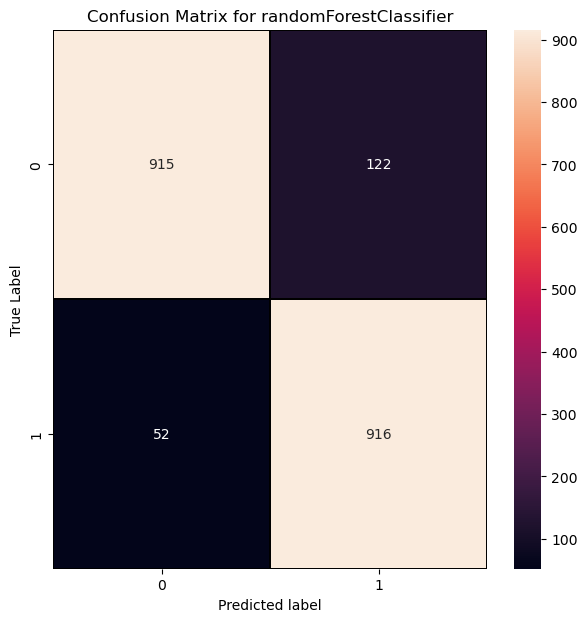

In [146]:
#Lets plot confusion mTatrix for RandomForestClassifier
cm=confusion_matrix(y_test,predRFC)
x_axis_labels=["0","1"]
y_axis_labels= ["0","1"]
f, ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm,annot=True, linewidths=0.2, linecolor="black",fmt=".0f",ax=ax, xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted label")
plt.ylabel("True Label")
plt.title("Confusion Matrix for randomForestClassifier")
plt.show()

In [147]:
svc=SVC()
svc.fit(x_train,y_train)
predsvc=svc.predict(x_test)
print(accuracy_score(y_test,predsvc))
print(confusion_matrix(y_test,predsvc))
print(classification_report(y_test,predsvc))
#checking cv score for Support Vector classifier
score2=cross_val_score(svc,x1,y1)
print(score2)
print(score2.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predsvc)-score2.mean())

0.8399002493765586
[[837 200]
 [121 847]]
              precision    recall  f1-score   support

         0.0       0.87      0.81      0.84      1037
         1.0       0.81      0.88      0.84       968

    accuracy                           0.84      2005
   macro avg       0.84      0.84      0.84      2005
weighted avg       0.84      0.84      0.84      2005

[0.70024938 0.61546135 0.68029925 0.77955112 0.80439122]
0.7159904629643457
Difference between Accuraccy_Score and CVS is = 0.12390978641221295


In [148]:
GB=GradientBoostingClassifier()
GB.fit(x_train,y_train)
predGB=GB.predict(x_test)
print(accuracy_score(y_test,predGB))
print(confusion_matrix(y_test,predGB))
print(classification_report(y_test,predGB))
#checking cv score for Gradient Boosting classifier
score3=cross_val_score(GB,x1,y1)
print(score3)
print(score3.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predGB)-score3.mean())

0.8603491271820449
[[881 156]
 [124 844]]
              precision    recall  f1-score   support

         0.0       0.88      0.85      0.86      1037
         1.0       0.84      0.87      0.86       968

    accuracy                           0.86      2005
   macro avg       0.86      0.86      0.86      2005
weighted avg       0.86      0.86      0.86      2005

[0.53566085 0.49825436 0.61147132 0.68977556 0.80538922]
0.6281102632639957
Difference between Accuraccy_Score and CVS is = 0.23223886391804927


In [149]:
ABC=AdaBoostClassifier()
ABC.fit(x_train,y_train)
predABC=ABC.predict(x_test)
print(accuracy_score(y_test,predABC))
print(confusion_matrix(y_test,predABC))
print(classification_report(y_test,predABC))
#checking cv score for AdaBoosting classifier
score4=cross_val_score(ABC,x1,y1)
print(score4)
print(score4.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predABC)-score4.mean())

0.8249376558603492
[[853 184]
 [167 801]]
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83      1037
         1.0       0.81      0.83      0.82       968

    accuracy                           0.82      2005
   macro avg       0.82      0.83      0.82      2005
weighted avg       0.83      0.82      0.82      2005

[0.51072319 0.51371571 0.58703242 0.68229426 0.75948104]
0.6106493247918129
Difference between Accuraccy_Score and CVS is = 0.2142883310685363


In [150]:
LR=LogisticRegression()
LR.fit(x_train,y_train)
predLR=LR.predict(x_test)
print(accuracy_score(y_test,predLR))
print(confusion_matrix(y_test,predLR))
print(classification_report(y_test,predLR))
#checking cv score for Logistic regresssion
score5=cross_val_score(LR,x1,y1)
print(score5)
print(score5.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predLR)-score5.mean())

0.7965087281795511
[[816 221]
 [187 781]]
              precision    recall  f1-score   support

         0.0       0.81      0.79      0.80      1037
         1.0       0.78      0.81      0.79       968

    accuracy                           0.80      2005
   macro avg       0.80      0.80      0.80      2005
weighted avg       0.80      0.80      0.80      2005

[0.71471322 0.72618454 0.67680798 0.78104738 0.83283433]
0.7463174897088616
Difference between Accuraccy_Score and CVS is = 0.050191238470689514


In [151]:
BC=BaggingClassifier()
BC.fit(x_train,y_train)
predBC=BC.predict(x_test)
print(accuracy_score(y_test,predBC))
print(confusion_matrix(y_test,predBC))
print(classification_report(y_test,predBC))
#checking cv score for Bagging classifier
score6=cross_val_score(BC,x1,y1)
print(score6)
print(score6.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predBC)-score6.mean())

0.8947630922693267
[[920 117]
 [ 94 874]]
              precision    recall  f1-score   support

         0.0       0.91      0.89      0.90      1037
         1.0       0.88      0.90      0.89       968

    accuracy                           0.89      2005
   macro avg       0.89      0.90      0.89      2005
weighted avg       0.90      0.89      0.89      2005

[0.52319202 0.62892768 0.64289277 0.77107232 0.85129741]
0.6834764386439092
Difference between Accuraccy_Score and CVS is = 0.21128665362541754


In [152]:
ET=ExtraTreesClassifier()
ET.fit(x_train,y_train)
predET=ET.predict(x_test)
print(accuracy_score(y_test,predET))
print(confusion_matrix(y_test,predET))
print(classification_report(y_test,predET))
#checking cv score for Extra Tree classifier
score7=cross_val_score(ET,x1,y1)
print(score7)
print(score7.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predET)-score7.mean())

0.9246882793017457
[[928 109]
 [ 42 926]]
              precision    recall  f1-score   support

         0.0       0.96      0.89      0.92      1037
         1.0       0.89      0.96      0.92       968

    accuracy                           0.92      2005
   macro avg       0.93      0.93      0.92      2005
weighted avg       0.93      0.92      0.92      2005

[0.73266833 0.67581047 0.71371571 0.84488778 0.90668663]
0.7747537842021692
Difference between Accuraccy_Score and CVS is = 0.14993449509957646


In [153]:
from sklearn.tree import DecisionTreeClassifier
DTC =DecisionTreeClassifier()
DTC.fit(x_train,y_train)
predDTC=DTC.predict(x_test)
print(accuracy_score(y_test,predDTC))
print(confusion_matrix(y_test,predDTC))
print(classification_report(y_test,predDTC))
#checking cv score for Decision Tree classifier
score8=cross_val_score(DTC,x1,y1)
print(score8)
print(score8.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predDTC)-score8.mean())

0.8219451371571073
[[823 214]
 [143 825]]
              precision    recall  f1-score   support

         0.0       0.85      0.79      0.82      1037
         1.0       0.79      0.85      0.82       968

    accuracy                           0.82      2005
   macro avg       0.82      0.82      0.82      2005
weighted avg       0.82      0.82      0.82      2005

[0.55112219 0.57206983 0.6394015  0.73017456 0.76796407]
0.6521464303313571
Difference between Accuraccy_Score and CVS is = 0.16979870682575016


In [154]:
knn =KNeighborsClassifier()
knn.fit(x_train,y_train)
predknn=knn.predict(x_test)
print(accuracy_score(y_test,predknn))
print(confusion_matrix(y_test,predknn))
print(classification_report(y_test,predknn))
#checking cv score for K Neighbors Classifier
score9=cross_val_score(knn,x1,y1)
print(score9)
print(score9.mean())
print("Difference between Accuraccy_Score and CVS is =", accuracy_score(y_test,predknn)-score9.mean())

0.8423940149625935
[[762 275]
 [ 41 927]]
              precision    recall  f1-score   support

         0.0       0.95      0.73      0.83      1037
         1.0       0.77      0.96      0.85       968

    accuracy                           0.84      2005
   macro avg       0.86      0.85      0.84      2005
weighted avg       0.86      0.84      0.84      2005

[0.69625935 0.59002494 0.70573566 0.77057357 0.80189621]
0.7128979447588614
Difference between Accuraccy_Score and CVS is = 0.1294960702037321


In [155]:
model=[('RandomForestClassifier',accuracy_score(y_test,predRFC),score1.mean(),accuracy_score(y_test,predRFC)-score1.mean()),
      ('SVC',accuracy_score(y_test,predsvc),score2.mean(),accuracy_score(y_test,predsvc)-score2.mean()),
      ('GradientBoostingClassifier',accuracy_score(y_test,predGB),score3.mean(),accuracy_score(y_test,predGB)-score3.mean()),
      ('AdaBoostClassifier',accuracy_score(y_test,predABC),score4.mean(),accuracy_score(y_test,predABC)-score4.mean()),
      ('LogisticRegression',accuracy_score(y_test,predLR),score5.mean(),accuracy_score(y_test,predLR)-score5.mean()),
      ('BaggingClassifier',accuracy_score(y_test,predBC),score6.mean(),accuracy_score(y_test,predBC)-score6.mean()),
      ('ExtraTreesClassifier',accuracy_score(y_test,predET),score7.mean(),accuracy_score(y_test,predET)-score7.mean()),
    ('DecisionTreesClassifier',accuracy_score(y_test,predDTC),score8.mean(),accuracy_score(y_test,predDTC)-score8.mean()),
    ('KNeighborsClassifier',accuracy_score(y_test,predknn),score9.mean(),accuracy_score(y_test,predknn)-score9.mean())
      ]

In [156]:
Model = pd.DataFrame(data = model, columns=['Model','Accuracy Score','Cross Validation', 'Difference'])
Model

,Model,Accuracy Score,Cross Validation,Difference
0,RandomForestClassifier,0.913217,0.718892,0.194325
1,SVC,0.839900,0.715990,0.123910
2,GradientBoostingClassifier,0.860349,0.628110,0.232239
3,AdaBoostClassifier,0.824938,0.610649,0.214288
4,LogisticRegression,0.796509,0.746317,0.050191
5,BaggingClassifier,0.894763,0.683476,0.211287
6,ExtraTreesClassifier,0.924688,0.774754,0.149934
7,DecisionTreesClassifier,0.821945,0.652146,0.169799
8,KNeighborsClassifier,0.842394,0.712898,0.129496


#### It is very clear that the best suitable model is Extra Tree Classifier. with Accuracy score 0.92 and cross-validation is 0.77

# Hyper Parameter Tuning

In [157]:
from sklearn.model_selection import RandomizedSearchCV
# Define the hyperparameters distribution to search
param_dist = {'criterion': ['gini','entropy'],
              'random_state':[10,50,1000],
    'n_estimators': [50, 100, 200, 400, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 15, 20],
    'min_samples_leaf': [1, 2, 4, 6, 8],
    'bootstrap': [False, True]
}

In [160]:
# Initialize RandomizedSearchCV with 5-fold cross-validation
random_search = RandomizedSearchCV(estimator=ET, param_distributions=param_dist, n_iter=100, cv=5, n_jobs=-1, verbose=2, random_state=56)

In [161]:
# Fit the model
random_search.fit(x1, y1)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=ExtraTreesClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [False, True],
                                        'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': [1, 2, 4, 6, 8],
                                        'min_samples_split': [2, 5, 10, 15, 20],
                                        'n_estimators': [50, 100, 200, 400,
                                                         500],
                                        'random_state': [10, 50, 1000]},
                   random_state=56, verbose=2)

In [162]:
# Print the best parameters and the best score
print("Best Parameters:", random_search.best_params_)
print("Best Score:", random_search.best_score_)

Best Parameters: {'random_state': 10, 'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': 30, 'criterion': 'entropy', 'bootstrap': False}
Best Score: 0.7737561286404746


In [163]:
# Get the best estimator
best_etc = random_search.best_estimator_

In [164]:
# Predict and evaluate
y_pred = best_etc.predict(x1)
print(classification_report(y1, y_pred))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      5012
         1.0       1.00      1.00      1.00      5012

    accuracy                           1.00     10024
   macro avg       1.00      1.00      1.00     10024
weighted avg       1.00      1.00      1.00     10024



In [165]:
Final_model=ExtraTreesClassifier(random_state=10, n_estimators=100, min_samples_split=5, min_samples_leaf=1, max_features='auto', max_depth=30, criterion= 'entropy', bootstrap= False)
Final_model.fit(x_train,y_train)
pred=Final_model.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

91.77057356608479


# Ploting ROC AUC Curve

In [166]:
#Plotting for all the models used here
from sklearn import datasets
from sklearn import metrics
from sklearn import model_selection
from sklearn.metrics import RocCurveDisplay

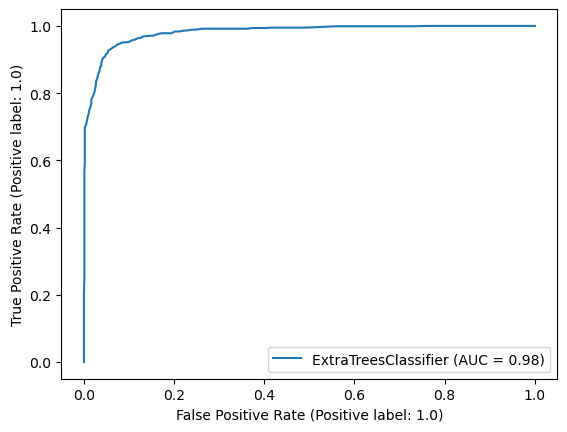

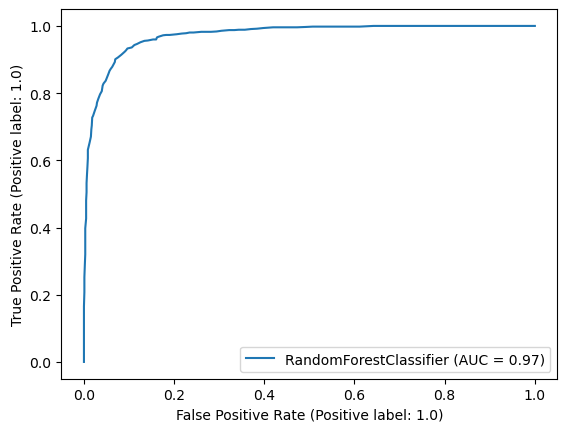

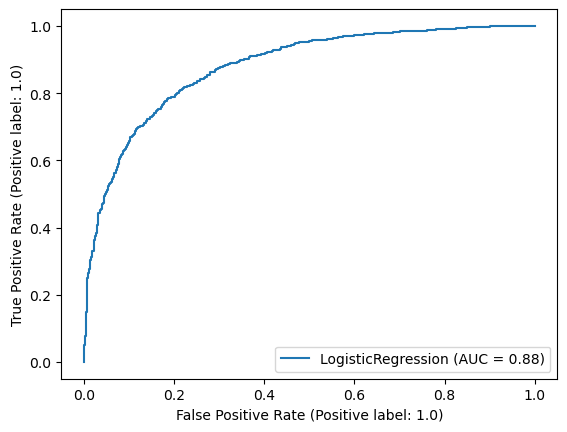

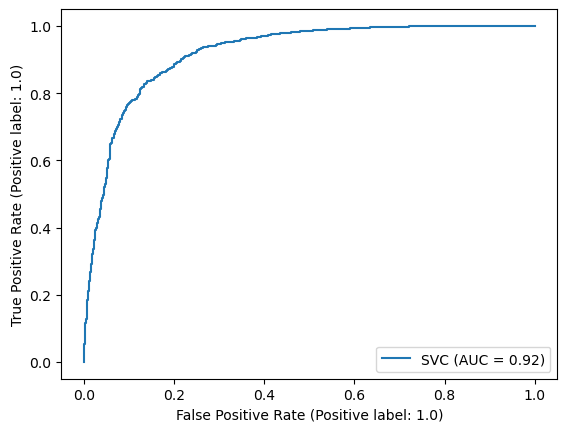

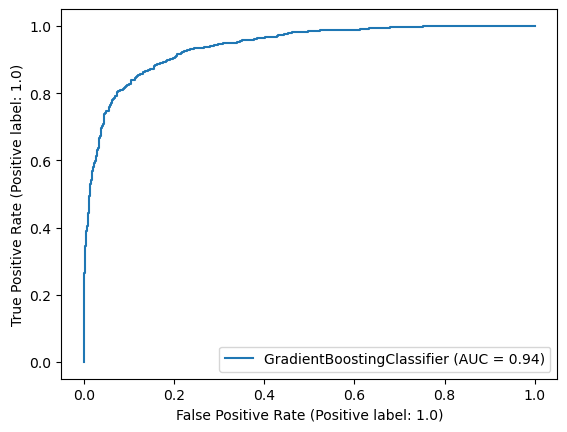

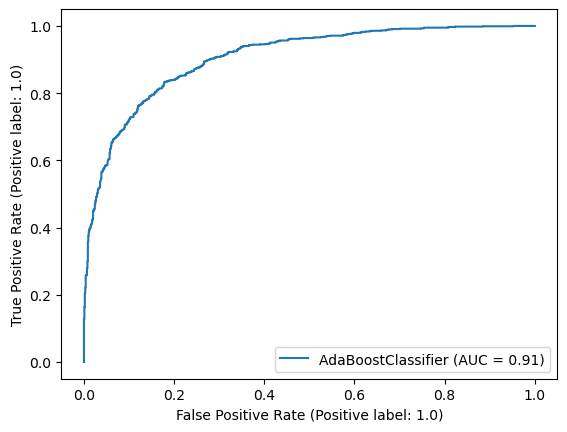

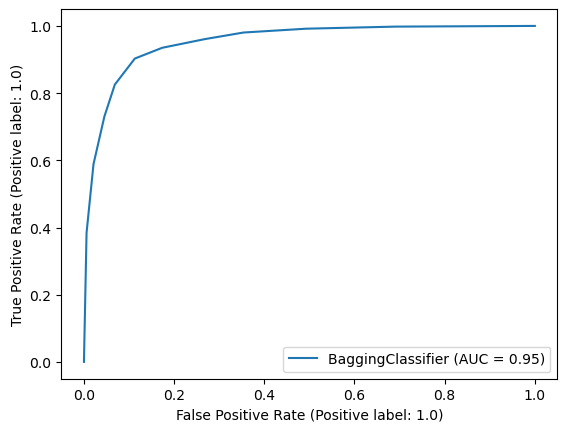

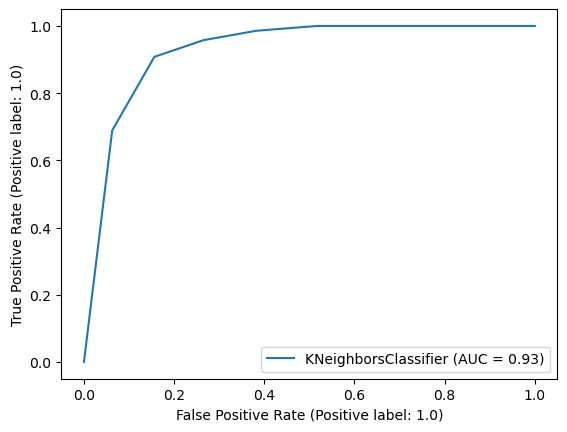

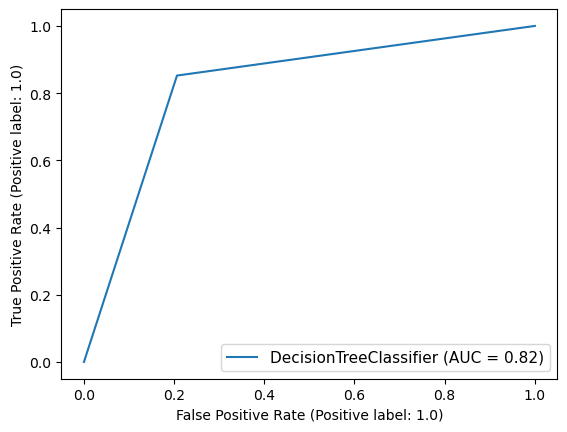

In [167]:
display= RocCurveDisplay.from_estimator(ET,x_test,y_test) #ax =Axes with confusion Matrix
RocCurveDisplay.from_estimator(RFC,x_test,y_test)
RocCurveDisplay.from_estimator(LR,x_test,y_test)
RocCurveDisplay.from_estimator(svc,x_test,y_test)
RocCurveDisplay.from_estimator(GB,x_test,y_test)
RocCurveDisplay.from_estimator(ABC,x_test,y_test)
RocCurveDisplay.from_estimator(BC,x_test,y_test)
RocCurveDisplay.from_estimator(knn,x_test,y_test)
RocCurveDisplay.from_estimator(DTC,x_test,y_test)

plt.legend(prop={'size':11},loc='lower right')
plt.show()

# Plotting ROC and compare AUC for the Best Model

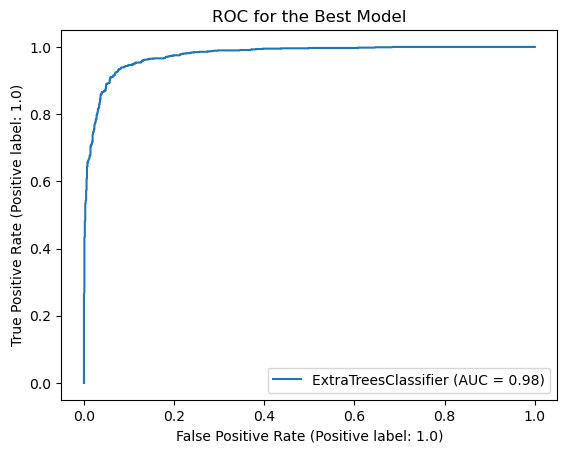

In [168]:
#Lets check the AUC for the best model after hyper parameter tuning
RocCurveDisplay.from_estimator(Final_model,x_test,y_test)
plt.title("ROC for the Best Model")
plt.show()

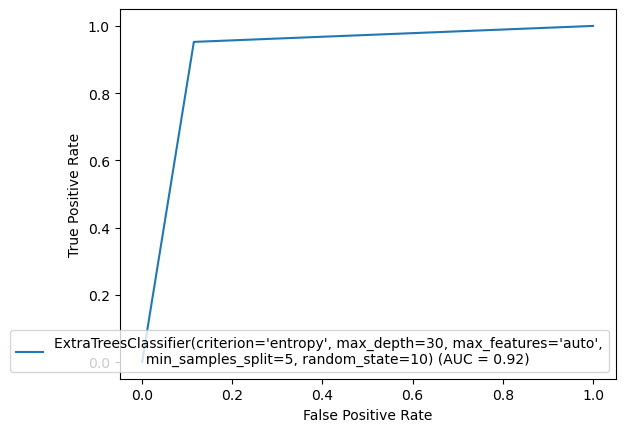

In [169]:
from sklearn import metrics
fpr,tpr,thesholds=metrics.roc_curve(y_test,pred)
roc_auc=metrics.auc(fpr,tpr)
display=metrics.RocCurveDisplay(fpr=fpr,tpr=tpr,roc_auc=roc_auc,estimator_name=Final_model)
display.plot()

#### Here we have plotted the ROC curve for the final model and the AUC value for the best model is 92%

In [170]:
#saving the model using .pkl
import joblib
joblib.dump(Final_model,"Rainfall_Weather_Forecasting.pkl")

['Rainfall_Weather_Forecasting.pkl']

# Predicting the saved model

In [171]:
#lets load the saved model and get the predictions
model=joblib.load('Rainfall_Weather_Forecasting.pkl')

#Prediction
prediction=model.predict(x_test)
prediction

array([1., 1., 1., ..., 0., 0., 1.])

#### these are predicted values of Rainfall Tomorrow

In [172]:
a=np.array(y_test)
df=pd.DataFrame()
df["Predicted"]=prediction
df["Original"]=a
df

,Predicted,Original
0,1.0,1.0
1,1.0,1.0
2,1.0,1.0
3,1.0,1.0
4,1.0,1.0
...,...,...
2000,0.0,0.0
2001,1.0,0.0
2002,0.0,0.0
2003,0.0,0.0


# We have predicted for 2005 rows using the best suitable model Extra Tree Classifier.

# Lets work on the Other Target 'RainFall'

In [173]:
df_rf

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,Rainfall,MinTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,0.0,12,2008,0.6,13.4,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,0.0,12,2008,0.0,7.4,...,4.0,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,0.0,12,2008,0.0,12.9,...,19.0,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,0.0,12,2008,0.0,9.2,...,11.0,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,0.0,12,2008,1.0,17.5,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,0.0,6,2017,0.0,3.5,...,15.0,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,0.0,6,2017,0.0,2.8,...,13.0,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,0.0,6,2017,0.0,3.6,...,13.0,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,0.0,6,2017,0.0,5.4,...,9.0,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


# Finding Skewness

In [174]:
df_rf.skew()

Location        -0.001876
WindGustDir      0.178050
WindDir9am       0.220812
WindDir3pm      -0.116938
RainToday        1.300888
RainTomorrow     1.274060
Month            0.025223
Year             0.356306
Rainfall         3.743947
MinTemp         -0.067972
MaxTemp          0.323254
Evaporation      1.607148
Sunshine        -0.333441
WindGustSpeed    0.644266
WindSpeed9am     0.899789
WindSpeed3pm     0.466967
Humidity9am     -0.222695
Humidity3pm      0.158191
Pressure9am     -0.046156
Pressure3pm     -0.011748
Cloud9am        -0.052278
Cloud3pm         0.016778
Temp9am         -0.055921
Temp3pm          0.352923
dtype: float64

#### We can only skew numerical data. So we will have to skew Evaporation, WindgustSpeed, WindSpeed9am

In [175]:
from sklearn.preprocessing import PowerTransformer
from scipy.stats import skew
# Initialize the PowerTransformer with Yeo-Johnson method
pt = PowerTransformer(method='yeo-johnson')
# Apply the PowerTransformer to Evaporation, WindGustSpeed, WindSpeed9am
df_rf[['Evaporation', 'WindGustSpeed', 'WindSpeed9am']] = pt.fit_transform(df_rf[['Evaporation', 'WindGustSpeed', 'WindSpeed9am']])

In [176]:
df_rf.skew()

Location        -0.001876
WindGustDir      0.178050
WindDir9am       0.220812
WindDir3pm      -0.116938
RainToday        1.300888
RainTomorrow     1.274060
Month            0.025223
Year             0.356306
Rainfall         3.743947
MinTemp         -0.067972
MaxTemp          0.323254
Evaporation      0.161616
Sunshine        -0.333441
WindGustSpeed   -0.010932
WindSpeed9am    -0.107236
WindSpeed3pm     0.466967
Humidity9am     -0.222695
Humidity3pm      0.158191
Pressure9am     -0.046156
Pressure3pm     -0.011748
Cloud9am        -0.052278
Cloud3pm         0.016778
Temp9am         -0.055921
Temp3pm          0.352923
dtype: float64

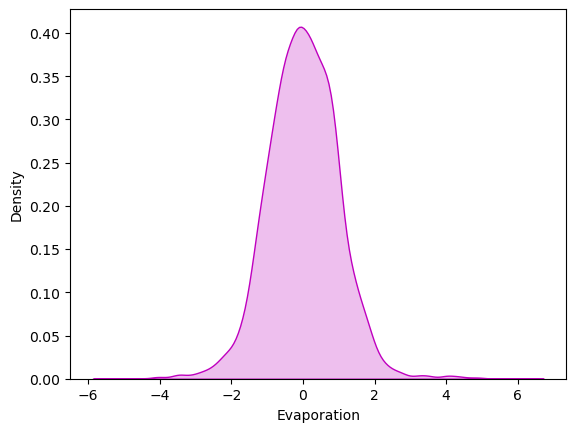

In [177]:
#Let Visualize if the skewness is removed. 
sns.distplot(df_rf["Evaporation"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

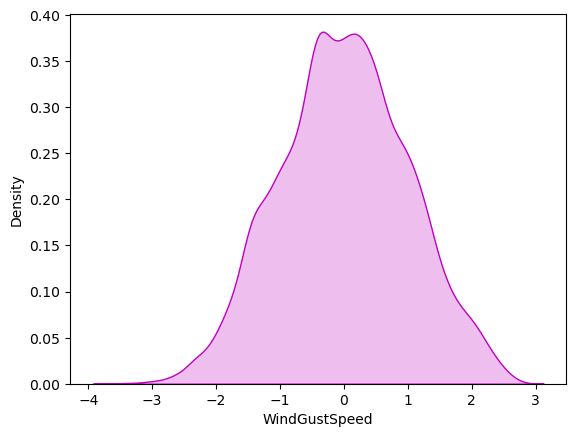

In [178]:
#Let Visualize if the skewness is removed. 
sns.distplot(df_rf["WindGustSpeed"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

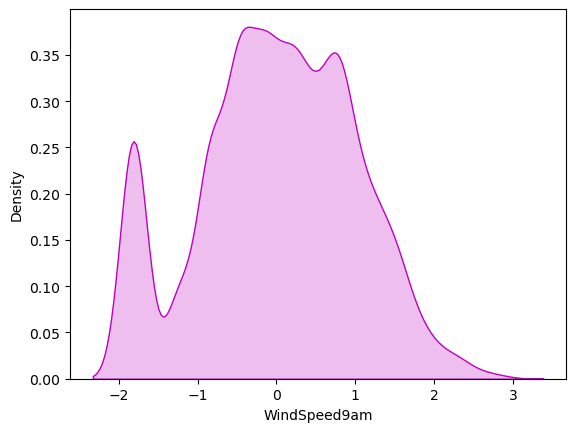

In [179]:
#Let Visualize if the skewness is removed. 
sns.distplot(df_rf["WindSpeed9am"], color='m', kde_kws={"shade":True}, hist=False)
plt.show()

# Separating Features and Label/target variables

In [180]:
x1=df_rf.drop("Rainfall",axis=1)
y1=df_rf["Rainfall"]

In [181]:
x1

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,MinTemp,MaxTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,1.0,13.0,13.0,14.0,0.0,0.0,12,2008,13.4,22.9,...,0.845220,24.0,71.0,22.0,1007.7,1007.1,8.000000,5.182827,16.9,21.8
1,1.0,14.0,6.0,15.0,0.0,0.0,12,2008,7.4,25.1,...,-0.851272,22.0,44.0,25.0,1010.6,1007.8,1.047056,1.649611,17.2,24.3
2,1.0,15.0,13.0,15.0,0.0,0.0,12,2008,12.9,25.7,...,0.767690,26.0,38.0,30.0,1007.6,1008.7,2.100946,2.000000,21.0,23.2
3,1.0,4.0,9.0,0.0,0.0,0.0,12,2008,9.2,28.0,...,0.050807,9.0,45.0,16.0,1017.6,1012.8,0.452548,1.061087,18.1,26.5
4,1.0,13.0,1.0,7.0,0.0,0.0,12,2008,17.5,32.3,...,-0.411422,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,9.0,0.0,2.0,0.0,0.0,0.0,6,2017,3.5,21.8,...,0.434102,13.0,59.0,27.0,1024.7,1021.2,1.697899,2.106836,9.4,20.9
8420,9.0,0.0,9.0,1.0,0.0,0.0,6,2017,2.8,23.4,...,0.249986,11.0,51.0,24.0,1024.6,1020.3,0.666422,1.503963,10.1,22.4
8421,9.0,6.0,9.0,3.0,0.0,0.0,6,2017,3.6,25.3,...,0.249986,9.0,56.0,21.0,1023.5,1019.1,0.532110,1.076773,10.9,24.5
8422,9.0,3.0,9.0,14.0,0.0,0.0,6,2017,5.4,26.9,...,-0.167544,9.0,53.0,24.0,1021.0,1016.8,0.779473,1.508223,12.5,26.1


In [182]:
y1

0       0.6
1       0.0
2       0.0
3       0.0
4       1.0
       ... 
8419    0.0
8420    0.0
8421    0.0
8422    0.0
8423    0.0
Name: Rainfall, Length: 6521, dtype: float64

# Feature Scaling using StandardScaler Method (Normalization)

# Multicollinearity

In [184]:
#Using Standard Scalar
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_scaler = pd.DataFrame(scaler.fit_transform(x1), columns=x1.columns)
x_scaler

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Month,Year,MinTemp,MaxTemp,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,-1.389911,1.243762,1.321845,1.374653,-0.542552,-0.548705,1.659654,-1.762453,0.066025,-0.192656,...,0.845220,0.703364,0.210413,-1.533818,-1.688238,-1.381773,1.437804,0.416019,-0.167162,-0.148015
1,-1.389911,1.452003,-0.218536,1.597403,-0.542552,-0.548705,1.659654,-1.762453,-1.009706,0.166435,...,-0.851272,0.490967,-1.373965,-1.371006,-1.210630,-1.265014,-1.161439,-0.988725,-0.114872,0.269878
2,-1.389911,1.660244,1.321845,1.597403,-0.542552,-0.548705,1.659654,-1.762453,-0.023619,0.264369,...,0.767690,0.915760,-1.726049,-1.099652,-1.704707,-1.114894,-0.767460,-0.849416,0.547470,0.086005
3,-1.389911,-0.630407,0.441628,-1.743842,-0.542552,-0.548705,1.659654,-1.762453,-0.686987,0.639782,...,0.050807,-0.889612,-1.315284,-1.859443,-0.057782,-0.431016,-1.383686,-1.222711,0.041999,0.637624
4,-1.389911,1.243762,-1.318808,-0.184594,-0.542552,-0.548705,1.659654,-1.762453,0.801108,1.341641,...,-0.411422,0.278570,0.855900,-0.936840,-1.177691,-1.565253,1.063971,1.536077,-0.010292,1.172528
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6516,1.193878,-1.463371,-1.098754,-1.743842,-0.542552,-0.548705,-0.129058,2.165569,-1.708931,-0.372201,...,0.434102,-0.464818,-0.493755,-1.262465,1.111536,0.970101,-0.918132,-0.806940,-1.474416,-0.298457
6517,1.193878,-1.463371,0.441628,-1.521092,-0.542552,-0.548705,-0.129058,2.165569,-1.834433,-0.111044,...,0.249986,-0.677215,-0.963200,-1.425277,1.095067,0.819982,-1.303733,-1.046632,-1.352406,-0.047721
6518,1.193878,-0.213925,0.441628,-1.075593,-0.542552,-0.548705,-0.129058,2.165569,-1.691002,0.199079,...,0.249986,-0.889612,-0.669797,-1.588089,0.913905,0.619822,-1.353943,-1.216475,-1.212965,0.303310
6519,1.193878,-0.838648,0.441628,1.374653,-0.542552,-0.548705,-0.129058,2.165569,-1.368283,0.460236,...,-0.167544,-0.889612,-0.845839,-1.425277,0.502173,0.236183,-1.261470,-1.044938,-0.934084,0.570762


In [185]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["Features"] = x1.columns
vif["VIF Values"]=[v(x_scaler,i) for i in range(x_scaler.shape[1])]
print("\nVIF values for each feature:")
print(vif)


VIF values for each feature:
         Features  VIF Values
0        Location    1.645682
1     WindGustDir    1.607077
2      WindDir9am    1.366227
3      WindDir3pm    1.485131
4       RainToday    1.421508
5    RainTomorrow    1.514628
6           Month    1.186431
7            Year    1.561886
8         MinTemp   10.332706
9         MaxTemp   39.334819
10    Evaporation    3.388627
11       Sunshine    7.394150
12  WindGustSpeed    4.116250
13   WindSpeed9am    2.345802
14   WindSpeed3pm    2.732192
15    Humidity9am    4.575562
16    Humidity3pm    6.814437
17    Pressure9am   24.799396
18    Pressure3pm   23.698579
19       Cloud9am    3.210686
20       Cloud3pm    3.218136
21        Temp9am   19.018796
22        Temp3pm   48.090319


#### As vif values for Temp3pm, Maxtemp, Pressure9am, Pressure3pm, temp9pm, is very high we will have to remove them 

In [ ]:
#Droping columns with high vif values 
x_scaler.drop("Temp3pm", axis=1,inplace=True)
x_scaler.drop("MaxTemp", axis=1,inplace=True) 

In [188]:
x_scaler.drop("Pressure9am", axis=1,inplace=True)
x_scaler.drop("MinTemp", axis=1,inplace=True)

In [189]:
#agin checking VIF values
vif=pd.DataFrame()
vif["VIF Values"]=[v(x_scaler.values,i) for i in range(len(x_scaler.columns))]
vif["Features"]=x_scaler.columns
vif

,VIF Values,Features
0,1.633690,Location
1,1.580139,WindGustDir
2,1.298122,WindDir9am
3,1.390299,WindDir3pm
4,1.353411,RainToday
5,1.498773,RainTomorrow
6,1.098534,Month
7,1.553687,Year
8,3.169344,Evaporation
9,6.572431,Sunshine


#### Again we can observe that Standard Scaler havs given us vif below 10. Hense the multicollinearity issue has been solved with Standard Scaler Technique

# Modelling or Model Buildingn and Cross_valuation Score

# For the Target 'Rainfall'

In [191]:
#Importing Libraries
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor,ExtraTreesRegressor
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor as KNN

In [197]:
maxAccu=0
maxRS=0
for i in range(0,100):
    x_train,x_test,y_train,y_test = train_test_split(x_scaler,y1,test_size=.20, random_state=i)
    lr=LinearRegression()
    lr.fit(x_train, y_train)
    pred = lr.predict(x_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Maximum r2 score is',maxAccu,'on Random_state',maxRS)

Maximum r2 score is 0.5151887716775545 on Random_state 24


In [202]:
x_train,x_test,y_train,y_test = train_test_split(x_scaler,y,test_size=.20, random_state=24)

In [203]:
print('Size of x_train : ', x_train.shape)
print('Size of y_train : ', y_train.shape)
print('Size of x_test : ', x_test.shape)
print('Size of y_test : ', y_test.shape)

Size of x_train :  (5216, 19)
Size of y_train :  (5216,)
Size of x_test :  (1305, 19)
Size of y_test :  (1305,)


In [204]:
LR = LinearRegression()
LR.fit(x_train,y_train)
pred_LR=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_LR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_LR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_LR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_LR)))
score = cross_val_score(LR,x_scaler,y1, cv=5, scoring='r2')
print(score)
print(score.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y_test,pred_LR) - score.mean())*100)

R2_score: 1.0
R2_score on training Data: 100.0
Mean Absolute Error:- 5.293764575272058e-16
Mean Squared Error:- 4.352123512397926e-31
Root Mean Squared Error:- 6.597062613313539e-16
[0.47596223 0.46371151 0.42419578 0.44266254 0.49146809]
0.4596000277086053
Difference between R2 score and cross validation score is = 54.039997229139466


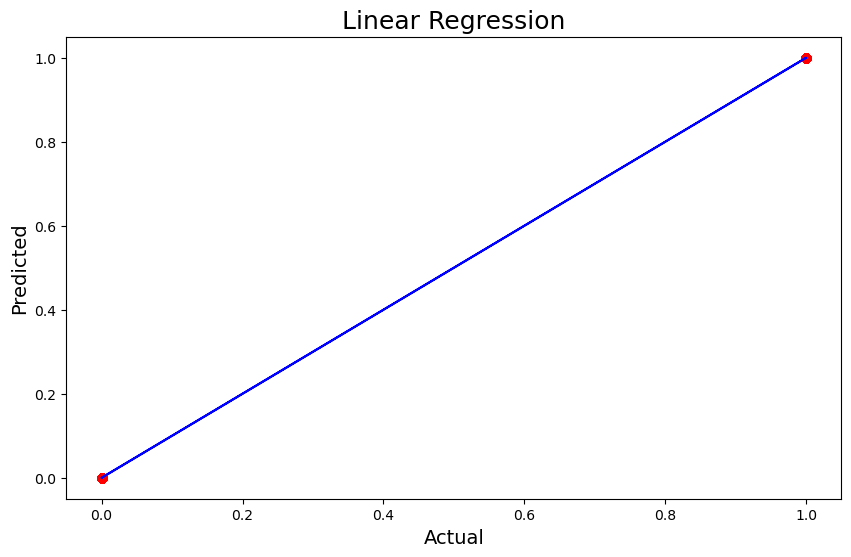

In [205]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_LR,y=y_test,color='r')
plt.plot(pred_LR,pred_LR,color='b')
plt.xlabel('Actual',fontsize=14)
plt.ylabel('Predicted', fontsize=14)
plt.title('Linear Regression', fontsize=18)
plt.show()

In [206]:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_RFR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_RFR)))
score1 = cross_val_score(RFR,x_scaler,y1)
print(score1)
print(score1.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_RFR) - score1.mean())*100)

R2_score: 1.0
R2_score on training Data: 100.0
Mean Absolute Error:- 0.0
Mean Squared Error:- 0.0
Root Mean Squared Error:- 0.0
[0.47263938 0.46011212 0.47412612 0.40546049 0.52561935]
0.4675914913944606
Difference between R2 score and cross validation score is –  53.24085086055395


In [207]:
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('R2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_knn))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_knn)))
score2 = cross_val_score(knn,x_scaler,y1)
print(score2)
print(score2.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y_test,pred_knn) - score2.mean())*100)

R2_score: 0.9705936578171092
R2_score on training Data: 97.96830395078204
Mean Absolute Error:- 0.013333333333333332
Mean Squared Error:- 0.005057471264367816
Root Mean Squared Error:- 0.07111590022187594
[0.38967905 0.41475565 0.36336411 0.44365153 0.40079485]
0.40244903933473175
Difference between R2 score and cross validation score is = 56.81446184823774


In [210]:
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_GBR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_GBR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_GBR)))
score3 = cross_val_score(GBR,x_scaler,y1)
print(score3)
print(score3.mean())
print('Difference between R2 score and cross validation score is –', (r2_score(y_test,pred_GBR) - score3.mean())*100)

R2_score: 0.9999999992937557
R2_score on training Data: 99.99999992944922
Mean Absolute Error:- 9.335155916186832e-06
Mean Squared Error:- 1.214639327748788e-10
Root Mean Squared Error:- 1.1021067678536357e-05
[0.46492866 0.47362521 0.4689579  0.42602232 0.50560035]
0.4678268883109011
Difference between R2 score and cross validation score is – 53.21731109828547


In [211]:
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('R2_score:',r2_score(y_test,pred_lasso))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_lasso))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_lasso)))
score4 = cross_val_score(lasso,x_scaler,y1)
print(score4)
print(score4.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_lasso) - score4.mean())*100)

R2_score: -0.0010436923448120528
R2_score on training Data: 0.0
Mean Absolute Error:- 0.35145573302305905
Mean Squared Error:- 0.17216523146344065
Root Mean Squared Error:- 0.4149279834663368
[0.43843691 0.41631931 0.39023244 0.40645702 0.43117959]
0.41652505175692
Difference between R2 score and cross validation score is –  -41.756874410173204


In [212]:
rd=Ridge()
rd.fit(x_train,y_train)
pred_rd=rd.predict(x_test)
pred_train=rd.predict(x_train)
print('R2_score:',r2_score(y_test,pred_rd))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_rd))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_rd))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_rd)))
score5 = cross_val_score(rd,x_scaler,y1)
print(score5)
print(score5.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_rd) - score5.mean())*100)

R2_score: 0.9999999439819002
R2_score on training Data: 99.99999455794169
Mean Absolute Error:- 7.461599115930435e-05
Mean Squared Error:- 9.634313861745254e-09
Root Mean Squared Error:- 9.815454070874793e-05
[0.47598474 0.46370701 0.42420734 0.44268265 0.49146223]
0.4596087917303537
Difference between R2 score and cross validation score is –  54.03911522515465


In [213]:
dt= DecisionTreeRegressor()
dt.fit(x_train,y_train)
pred_dt=dt.predict(x_test)
pred_train=dt.predict(x_train)
print('R2_score:',r2_score(y_test,pred_dt))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_dt))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_dt))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_dt)))
score6 = cross_val_score(dt,x_scaler,y1)
print(score6)
print(score6.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_dt) - score6.mean())*100)

R2_score: 1.0
R2_score on training Data: 100.0
Mean Absolute Error:- 0.0
Mean Squared Error:- 0.0
Root Mean Squared Error:- 0.0
[-0.18189688  0.2169311  -0.03264236 -0.07855137  0.1783522 ]
0.02043853699000355
Difference between R2 score and cross validation score is –  97.95614630099965


In [214]:
svr= SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print('R2_score:',r2_score(y_test,pred_svr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_svr))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_svr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_svr)))
score7 = cross_val_score(svr,x_scaler,y1)
print(score7)
print(score7.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_svr) - score7.mean())*100)

R2_score: 0.9769943963370077
R2_score on training Data: 98.34013705367934
Mean Absolute Error:- 0.04872145884171399
Mean Squared Error:- 0.0039566355693403275
Root Mean Squared Error:- 0.06290179305346015
[0.40596526 0.35821938 0.32614331 0.36762215 0.39603994]
0.3707980086944179
Difference between R2 score and cross validation score is –  60.61963876425898


In [215]:
etr=ExtraTreesRegressor()
etr.fit(x_train,y_train)
pred_etr=etr.predict(x_test)
pred_train=etr.predict(x_train)
print('R2_score:',r2_score(y_test,pred_etr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_etr))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_etr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_etr)))
score8 = cross_val_score(etr,x_scaler,y1)
print(score8)
print(score8.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_etr) - score8.mean())*100)

R2_score: 1.0
R2_score on training Data: 100.0
Mean Absolute Error:- 0.0
Mean Squared Error:- 0.0
Root Mean Squared Error:- 0.0
[0.50359935 0.46513095 0.48706358 0.42060364 0.5570514 ]
0.48668978323782286
Difference between R2 score and cross validation score is –  51.331021676217716


In [216]:
model = [('Linear Regression', r2_score(y_test,pred_LR),np.sqrt(mean_squared_error(y_test, pred_LR)),score.mean()),
          ('Random Forest Regressor',r2_score(y_test,pred_RFR),np.sqrt(mean_squared_error(y_test, pred_RFR)),score1.mean()),
          ('KNN',r2_score(y_test,pred_knn),np.sqrt(mean_squared_error(y_test, pred_knn)),score2.mean()),
          ('GradientBoostingRegressor',r2_score(y_test,pred_GBR),np.sqrt(mean_squared_error(y_test, pred_GBR)),score3.mean()),
         ('Lasso',r2_score(y_test,pred_lasso),np.sqrt(mean_squared_error(y_test, pred_lasso)),score4.mean()),
         ('Ridge',r2_score(y_test,pred_rd),np.sqrt(mean_squared_error(y_test, pred_rd)),score5.mean()),
         ('DecisionTreeRegressor',r2_score(y_test,pred_dt),np.sqrt(mean_squared_error(y_test, pred_dt)),score6.mean()),
         ('SVR',r2_score(y_test,pred_svr),np.sqrt(mean_squared_error(y_test, pred_svr)),score7.mean()),
         ('ExtraTreesRegressor',r2_score(y_test,pred_etr),np.sqrt(mean_squared_error(y_test, pred_etr)),score8.mean())
        ]

In [217]:
Model = pd.DataFrame(data = model, columns=['Model','R2_Score(test)','RMSE', 'Cross-Validation'])
Model

,Model,R2_Score(test),RMSE,Cross-Validation
0,Linear Regression,1.000000,6.597063e-16,0.459600
1,Random Forest Regressor,1.000000,0.000000e+00,0.467591
2,KNN,0.970594,7.111590e-02,0.402449
3,GradientBoostingRegressor,1.000000,1.102107e-05,0.467827
4,Lasso,-0.001044,4.149280e-01,0.416525
5,Ridge,1.000000,9.815454e-05,0.459609
6,DecisionTreeRegressor,1.000000,0.000000e+00,0.020439
7,SVR,0.976994,6.290179e-02,0.370798
8,ExtraTreesRegressor,1.000000,0.000000e+00,0.486690


#### From the above observation , it can be concluded that Extra Tree Regresssor is the best Model having r2_score as 1.00 and CV as 0.49 so the difference is 0.51.

# Hyper Parameter Tuning :

In [220]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
etr=ExtraTreesRegressor(random_state=24)
# Define the parameter distribution
parameters = {
    'n_estimators': randint(100, 300),
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 5),
    'max_features': ['auto', 'sqrt', 'log2']
}
# Perform Randomized Search with cross-validation
random_search = RandomizedSearchCV(estimator=etr, param_distributions=parameters, cv=3, n_jobs=-1,verbose=2)

In [221]:
random_search.fit(x_train, y_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


RandomizedSearchCV(cv=3, estimator=ExtraTreesRegressor(random_state=24),
                   n_jobs=-1,
                   param_distributions={'max_depth': [None, 10, 20, 30],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x0000021BE74B3350>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x0000021BE74A44D0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x0000021BE7491F90>},
                   verbose=2)

In [222]:
# Get the best estimator
best_model = random_search.best_estimator_

In [223]:
best_model

ExtraTreesRegressor(max_features='auto', min_samples_leaf=2,
                    min_samples_split=5, n_estimators=240, random_state=24)

In [224]:
Model=ExtraTreesRegressor(max_depth=20, max_features='auto', min_samples_split=5,
                    n_estimators=240, random_state=24)
Model.fit(x_train,y_train)
pred=Model.predict(x_test)
print('R2_score:',r2_score(y_test,pred))
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred))
print('Mean Squared Error:-',mean_squared_error(y_test, pred))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred)))

R2_score: 1.0
Mean Absolute Error:- 0.0
Mean Squared Error:- 0.0
Root Mean Squared Error:- 0.0


# Saving the model

In [225]:
import joblib
joblib.dump(random_search.best_estimator_,"Rainfall_Weather_Pred.obj")

['Rainfall_Weather_Pred.obj']

In [226]:
Model=joblib.load('Rainfall_Weather_Pred.obj')
Predicted = Model.predict(x_test)
Predicted

array([0., 0., 0., ..., 0., 0., 0.])

In [227]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
pd.DataFrame([Model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

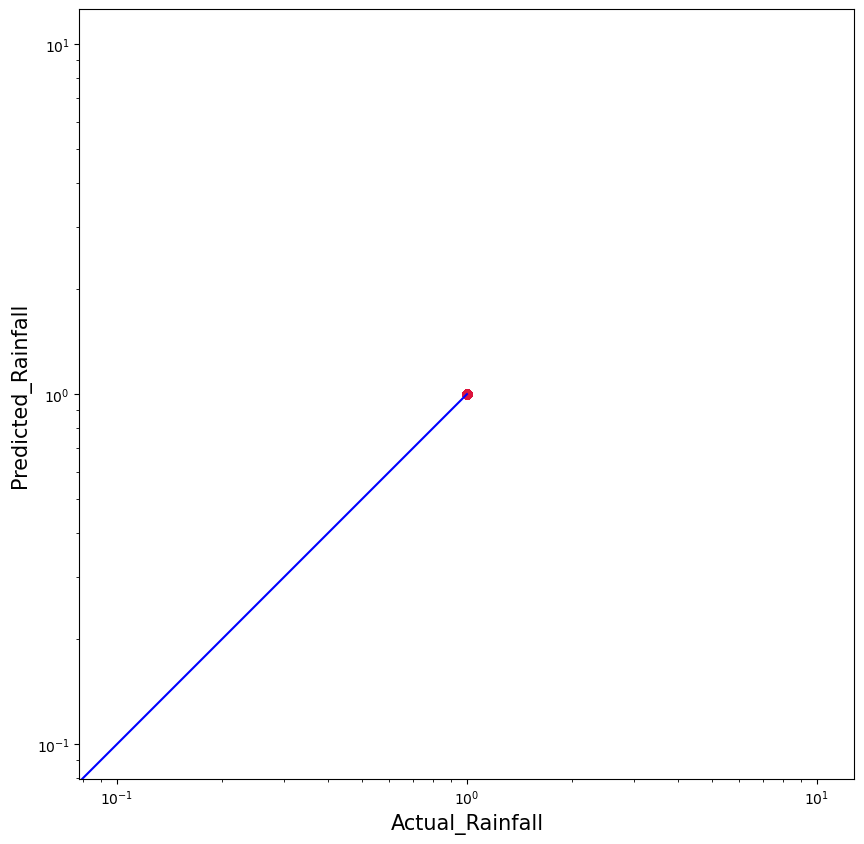

In [228]:
plt.figure(figsize=(10,10))
plt.scatter(y_test, Predicted, c='crimson')
plt.yscale('log')
plt.xscale('log')
p1 = max(max(Predicted), max(y_test))
p2 = min(min(Predicted), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual_Rainfall', fontsize=15)
plt.ylabel('Predicted_Rainfall', fontsize=15)
plt.axis('equal')
plt.show()

# We have almost reached the accuracy of the Model using Extra Tree Regressor